<a href="https://colab.research.google.com/github/potapov-dm/numbers_generation_cDCGAN/blob/main/EMNIST_cDCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [41]:
import importlib
if importlib.util.find_spec("imageio") is None:
    !pip install imageio
if importlib.util.find_spec("tensorflow_docs") is None:
    !pip install git+https://github.com/tensorflow/docs

import imageio
import tensorflow_docs.vis.embed as embed

In [42]:
import time
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.initializers import RandomNormal

import os
import glob
from IPython import display

In [43]:
def make_generator_model():
  noise = tf.keras.Input(shape=(NOISE_DIM,))
  label = tf.keras.Input(shape=(1,))

  label_embedding = layers.Embedding(NUM_OF_CLASSES, NUM_OF_CLASSES)(label)
  label_embedding = layers.Flatten()(label_embedding)

  input_concat = layers.Concatenate()([noise, label_embedding])

  dense = layers.Dense(7*7*128, use_bias=False, kernel_initializer=RandomNormal(mean=0.0, stddev=0.02))(input_concat)
  dense = layers.BatchNormalization()(dense)
  dense = layers.LeakyReLU()(dense)

  reshaped = layers.Reshape((7, 7, 128))(dense)

  upsample1 = layers.Conv2DTranspose(64, (5, 5), strides=(1, 1), padding='same', use_bias=False, kernel_initializer=RandomNormal(mean=0.0, stddev=0.02))(reshaped)
  upsample1 = layers.BatchNormalization()(upsample1)
  upsample1 = layers.LeakyReLU()(upsample1)

  upsample2 = layers.Conv2DTranspose(32, (5, 5), strides=(2, 2), padding='same', use_bias=False, kernel_initializer=RandomNormal(mean=0.0, stddev=0.02))(upsample1)
  upsample2 = layers.BatchNormalization()(upsample2)
  upsample2 = layers.LeakyReLU()(upsample2)

  output = layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh', kernel_initializer=RandomNormal(mean=0.0, stddev=0.02))(upsample2)

  model = tf.keras.Model(inputs=[noise, label], outputs=output)
  return model

# g = make_generator_model()
# display(tf.keras.utils.plot_model(g, show_shapes=True))

In [44]:
def make_discriminator_model():
    image_input = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 1))
    label_input = layers.Input(shape=(1,))

    label_embedding = layers.Embedding(NUM_OF_CLASSES, NUM_OF_CLASSES)(label_input)
    label_embedding = layers.Dense(IMG_SIZE*IMG_SIZE, kernel_initializer=RandomNormal(mean=0.0, stddev=0.02))(label_embedding)
    label_embedding = layers.Reshape((IMG_SIZE, IMG_SIZE, 1))(label_embedding)

    input_concat = layers.Concatenate()([image_input, label_embedding])

    conv1 = layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', kernel_initializer=RandomNormal(mean=0.0, stddev=0.02))(input_concat)
    conv1 = layers.LeakyReLU()(conv1)
    conv1 = layers.Dropout(0.3)(conv1)

    conv2 = layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same', kernel_initializer=RandomNormal(mean=0.0, stddev=0.02))(conv1)
    conv2 = layers.BatchNormalization()(conv2)
    conv2 = layers.LeakyReLU()(conv2)
    conv2 = layers.Dropout(0.3)(conv2)

    flatten = layers.Flatten()(conv2)
    output = layers.Dense(1, kernel_initializer=RandomNormal(mean=0.0, stddev=0.02))(flatten)

    model = tf.keras.Model(inputs=[image_input, label_input], outputs=output)
    return model

In [45]:
from google.colab import drive
drive.mount('/content/drive')

def dataset_init(img_size):
  df = pd.read_csv('/content/drive/MyDrive/EMNIST/emnist-byclass-train-eddited.csv', header=None)

  all_labels = [10,12,13,14,18,21,23,24,27,28,29,30,34,35,36,38,39,40,44,47,49,50,53,54,55,56,60,61]
  # A-10, C-12, D-13, E-14, I-18, L-21, N-23, O-24, R-27, S-28, T-29, U-30, Y-34, Z-35, a-36, c-38, d-39, e-40, i-44, l-47, n-49, o-50, r-53, s-54, t-55, u-56, y-60, z-61
  values_to_remove = [18, 38, 50, 54] # drop I с o s
  current_labels = [value for value in all_labels if value not in values_to_remove]
  df = df.loc[~df[0].isin(values_to_remove)]
  label_map = {label: i for i, label in enumerate(current_labels)}
  df[0] = df[0].replace(label_map)

  min_count = df[0].value_counts().min()
  class_labels = df[0].unique()
  filtered_df = pd.DataFrame(columns=df.columns)
  for label in class_labels:
      class_samples = df[df[0] == label].sample(min_count, random_state=42)
      filtered_df = pd.concat([filtered_df, class_samples], ignore_index=True)

  x_train = filtered_df.drop(columns=[0], axis=1).values.astype('float32')
  y_train = filtered_df[0].values.astype('int64')
  del df
  del filtered_df

  def preprocess_image(image):
    image = tf.reshape(image, (28, 28, 1))
    image = tf.image.flip_left_right(image)
    image = tf.image.rot90(image)
    image = tf.image.resize(image, (img_size, img_size))
    image = (tf.cast(image, tf.float32) - 127.5) / 127.5
    return image

  def preprocess_label(label):
    return tf.cast(label, tf.int64)

  train_dataset = tf.data.Dataset.from_tensor_slices((x_train, y_train))
  del x_train
  del y_train

  train_dataset = train_dataset.map(lambda x, y: (preprocess_image(x), preprocess_label(y)))
  train_dataset = train_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

  AUTOTUNE = tf.data.AUTOTUNE
  train_dataset = train_dataset.cache().prefetch(buffer_size=AUTOTUNE)

  return train_dataset

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [46]:
def generate_and_save_images(model, epoch, image_input, label_input):
  predictions = model([image_input, label_input], training=False)

  fig = plt.figure(figsize=(18,6))
  columns_n = (len(label_input) // NUM_OF_CLASSES) * 3
  for i in range(predictions.shape[0]):
      plt.subplot(len(label_input) // columns_n, columns_n, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
      plt.axis('off')

  plt.text(0.5, 0.05, f'Epoch {epoch}', horizontalalignment='center', verticalalignment='center', transform=fig.transFigure)

  plt.savefig('image_at_epoch_{:03d}.png'.format(epoch))
  plt.show()

In [47]:
def discriminator_loss(real_output, fake_output):
  shape_real = tf.shape(real_output)
  random_tensor_ones = tf.random.uniform(shape_real, minval=0.85, maxval=1.05)
  smooth_ones = tf.ones_like(real_output) * random_tensor_ones

  shape_fake = tf.shape(fake_output)
  random_tensor_zeros = tf.random.uniform(shape_fake, minval=0, maxval=0.1)
  smooth_zeros = tf.zeros_like(fake_output) + random_tensor_zeros

  real_loss = cross_entropy(smooth_ones, real_output)
  fake_loss = cross_entropy(smooth_zeros, fake_output)

  return real_loss + fake_loss

def generator_loss(fake_output):
  shape_fake = tf.shape(fake_output)
  random_tensor = tf.random.uniform(shape_fake, minval=0.85, maxval=1.05)
  smooth_ones = tf.ones_like(fake_output) * random_tensor
  return cross_entropy(smooth_ones, fake_output)

# Train

In [48]:
@tf.function
def train_step(image_batch, label_batch):
  noise_batch = tf.random.normal((len(label_batch), NOISE_DIM))

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_batch = generator([noise_batch, label_batch], training=True)

    real_output = discriminator([image_batch, label_batch], training=True)
    fake_output = discriminator([generated_batch, label_batch], training=True)

    disc_loss = discriminator_loss(real_output, fake_output)
    gen_loss = generator_loss(fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [49]:
def train(dataset, epochs):
  for epoch in range(epochs):
    start_time = time.time()
    if(epoch+1) == 25 or (epoch+1) == 55 or (epoch+1) == 75:
      generator_optimizer.learning_rate.assign(generator_optimizer.learning_rate / 2.0)
      discriminator_optimizer.learning_rate.assign(discriminator_optimizer.learning_rate / 2.0)
      print("\nlearning rate change!")

    for image_batch, label_batch in train_dataset:
      train_step(image_batch, label_batch)

    # Produce images for the GIF as you go
    # display.clear_output(wait=True)
    print('[%d/%d] - time: %.2f' % ((epoch + 1), epochs, time.time() - start_time))

    generate_and_save_images(generator, epoch + 1, SEED, SEED_LABELS)

In [50]:
IMG_SIZE = 28
NUM_OF_CLASSES = 28 - 4
BUFFER_SIZE = 67000
BATCH_SIZE = 64 #128
NOISE_DIM = 40 #100

train_dataset = dataset_init(IMG_SIZE)

SEED = tf.random.normal((NUM_OF_CLASSES*10, NOISE_DIM))
SEED_LABELS = tf.repeat(tf.range(NUM_OF_CLASSES), 10)

In [51]:
LEARNING_RATE = 0.0008
EPOCHS = 80

[1/80] - time: 19.89


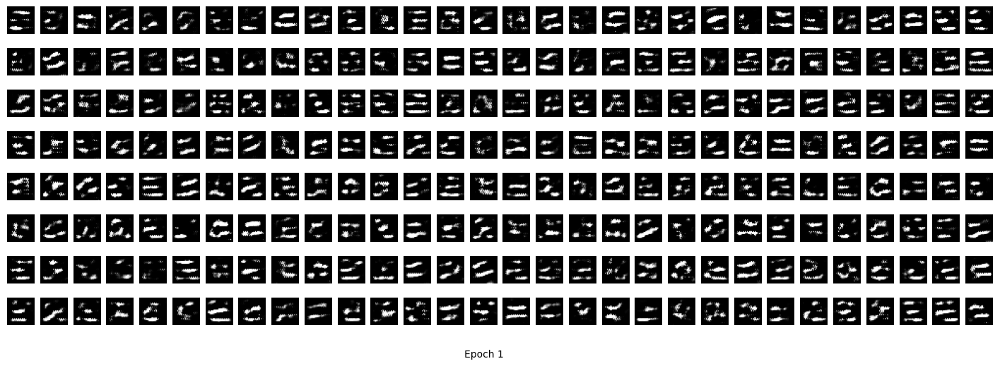

[2/80] - time: 9.15


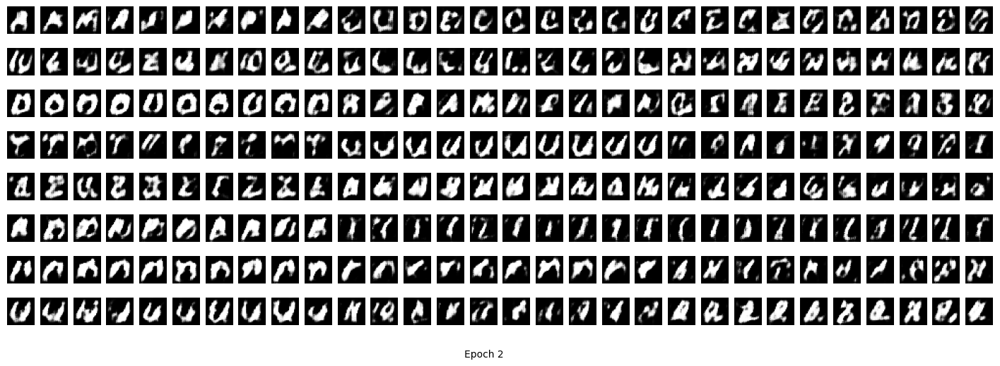

[3/80] - time: 8.62


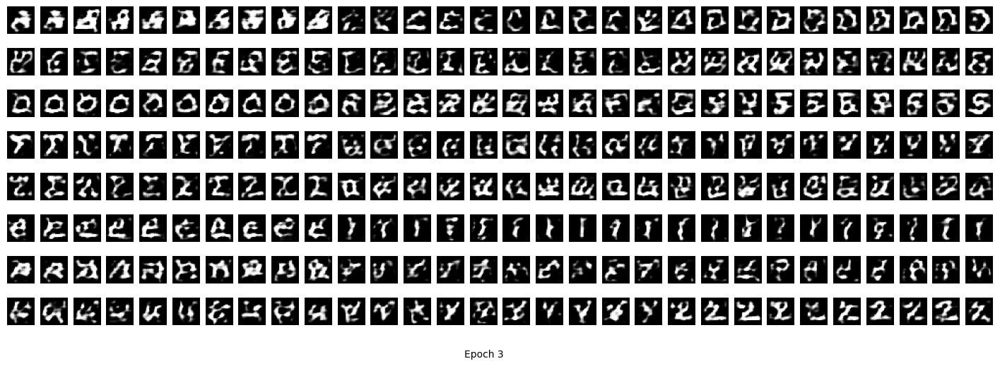

[4/80] - time: 9.15


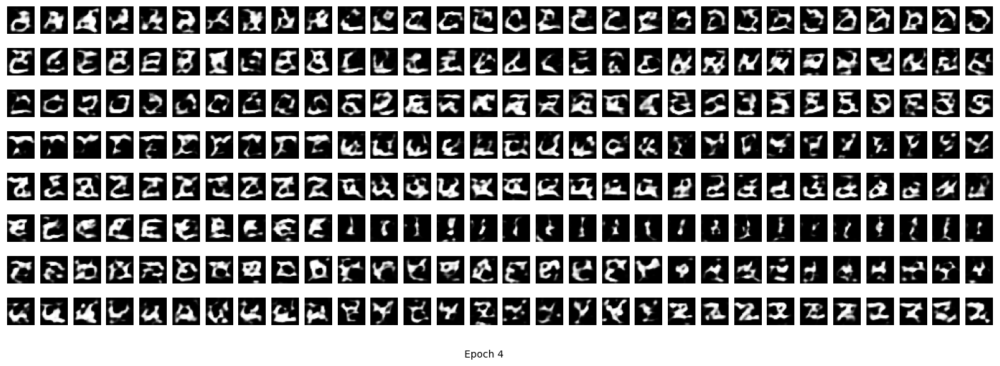

[5/80] - time: 9.16


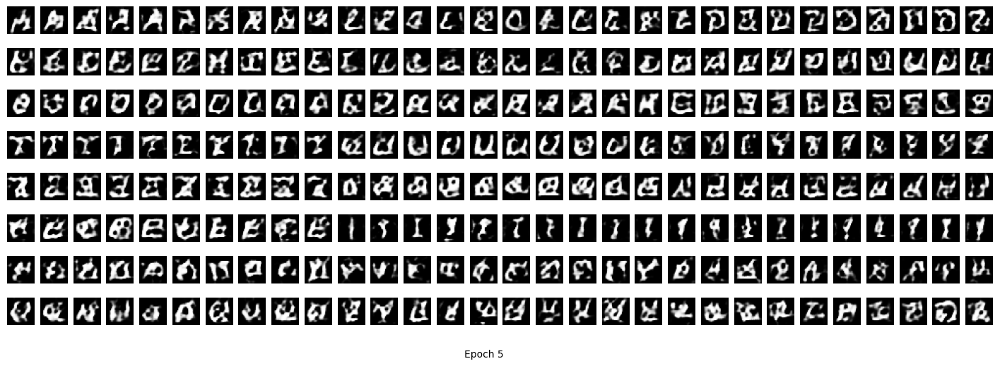

[6/80] - time: 8.68


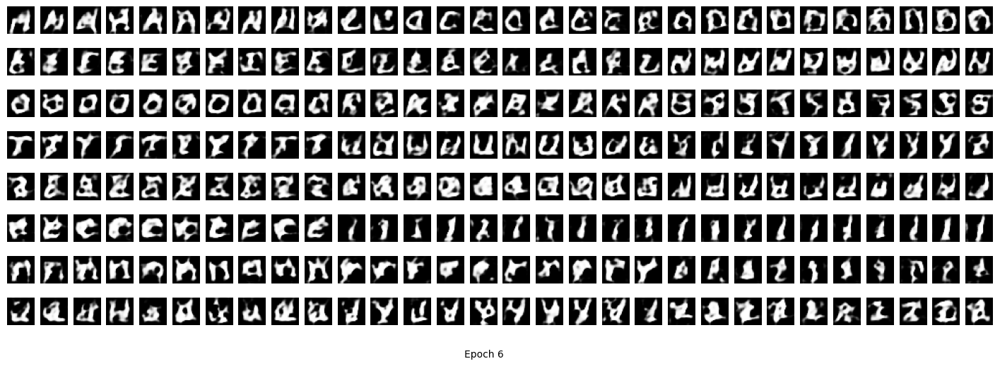

[7/80] - time: 9.18


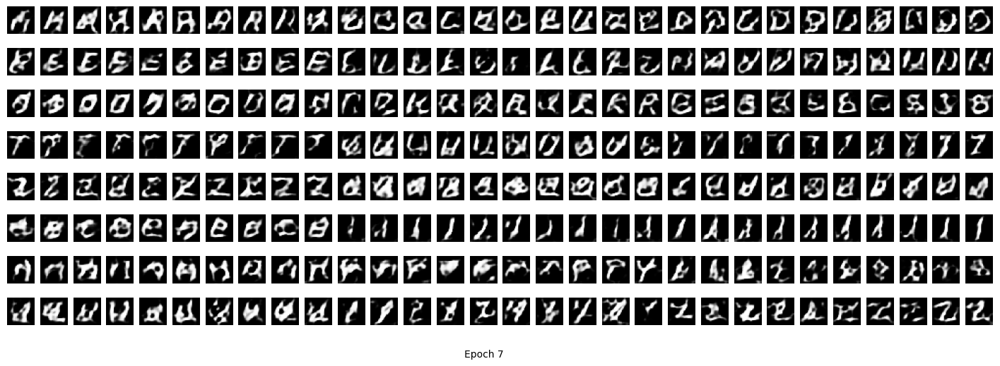

[8/80] - time: 9.24


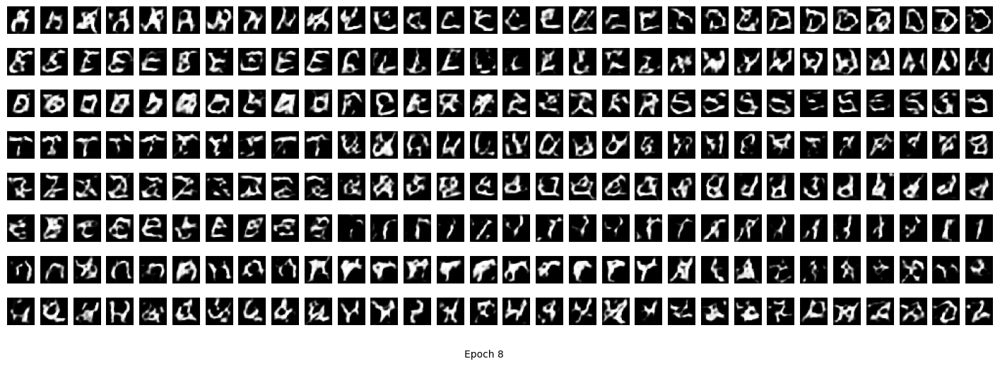

[9/80] - time: 8.89


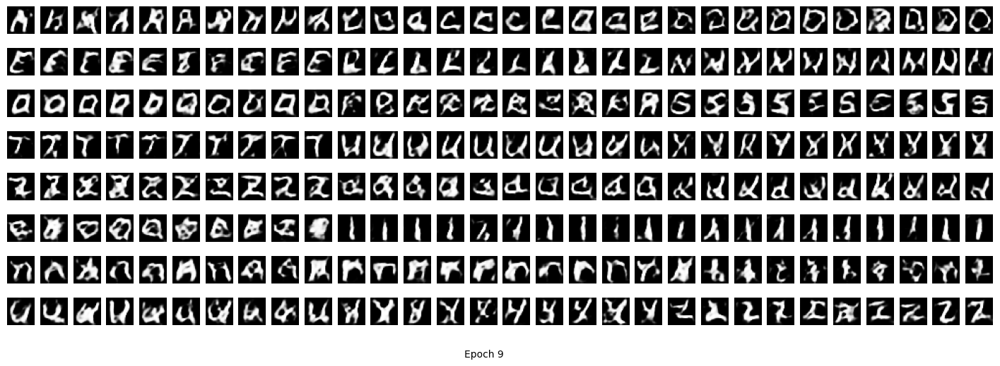

[10/80] - time: 9.18


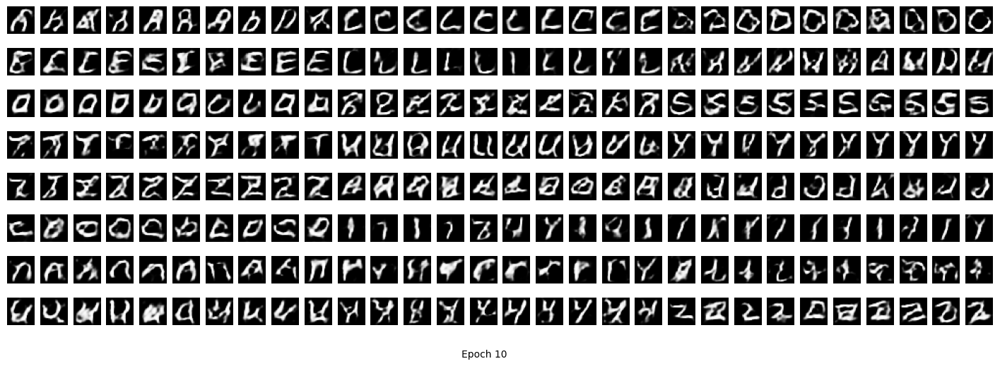

[11/80] - time: 9.25


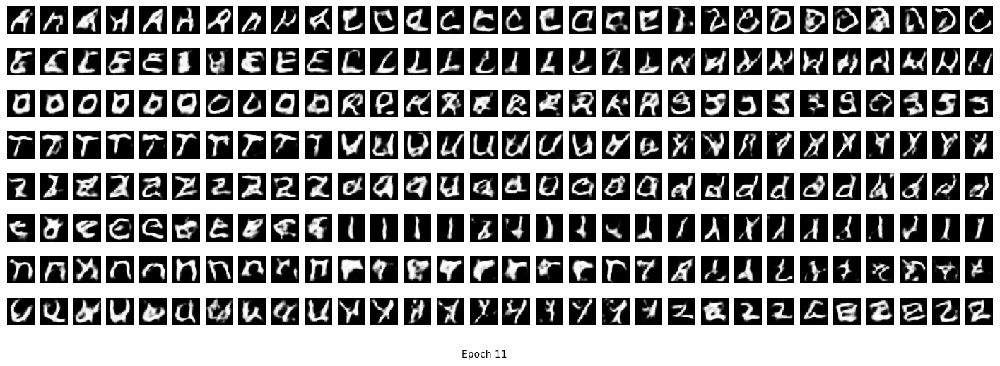

[12/80] - time: 8.79


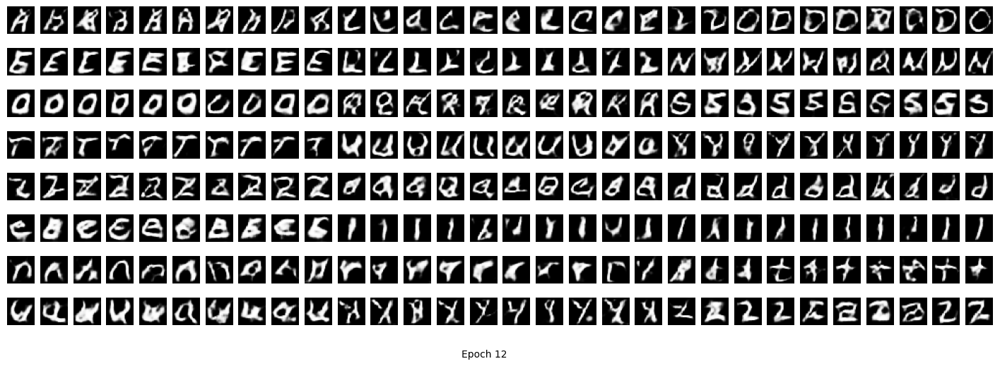

[13/80] - time: 10.22


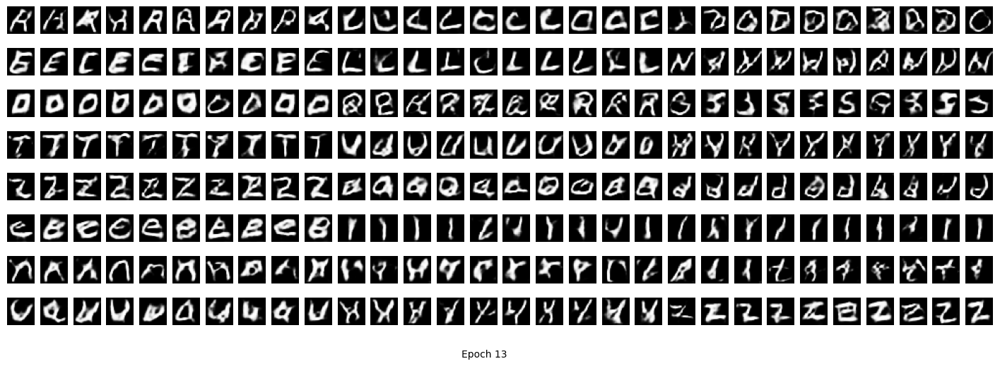

[14/80] - time: 9.46


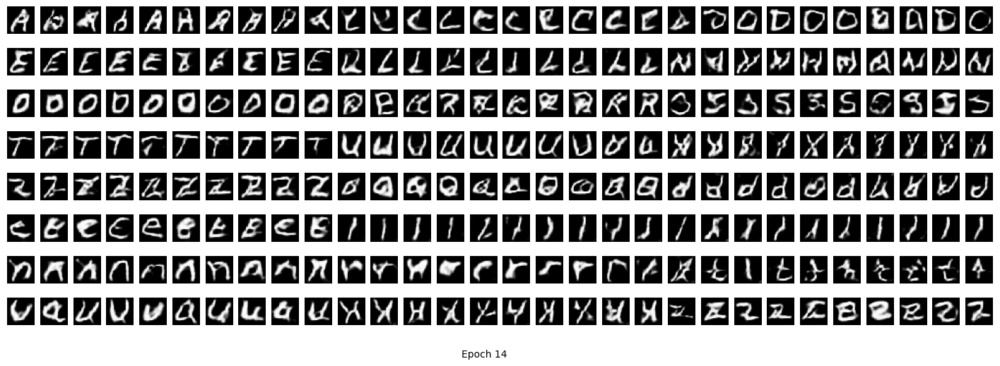

[15/80] - time: 8.85


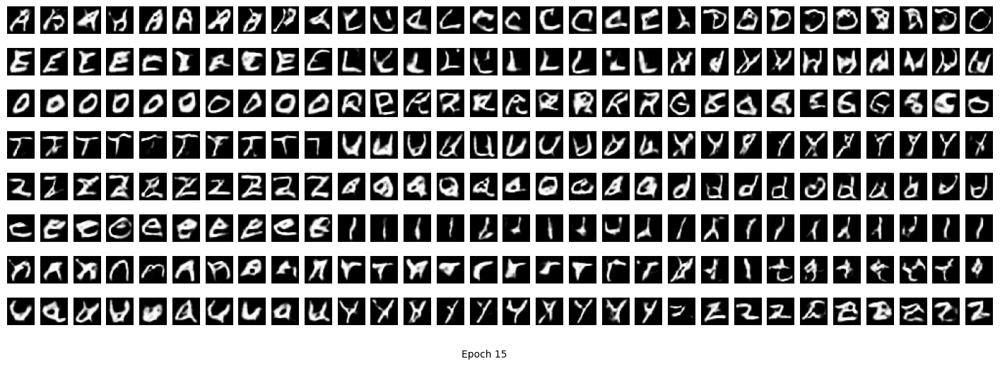

[16/80] - time: 9.28


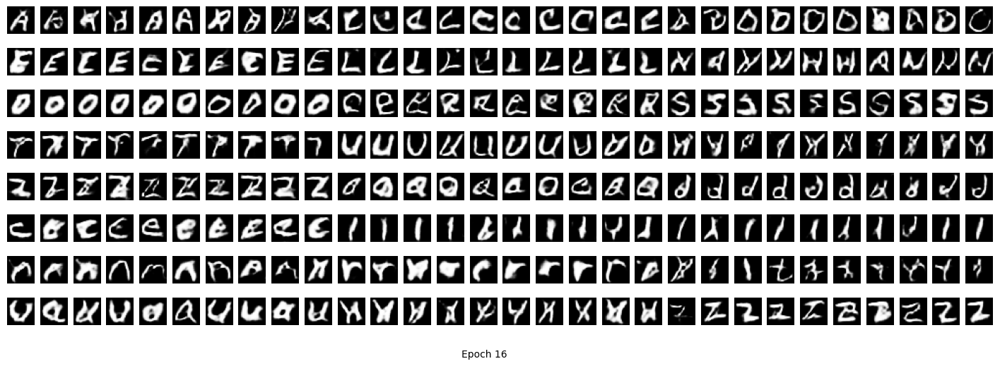

[17/80] - time: 9.28


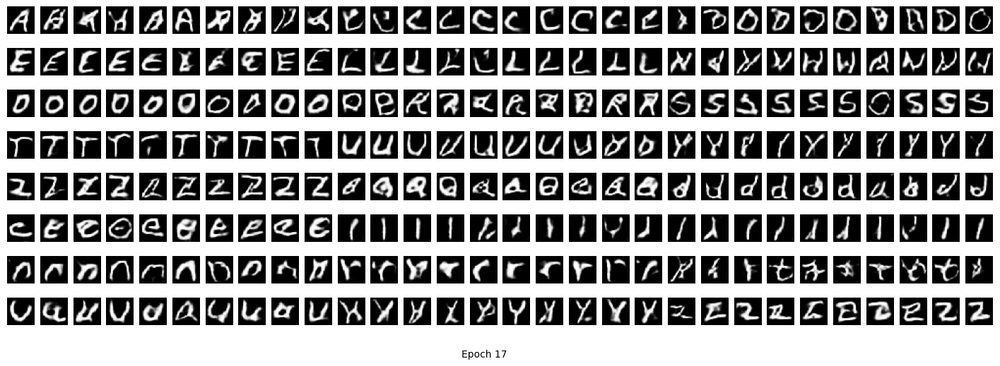

[18/80] - time: 8.91


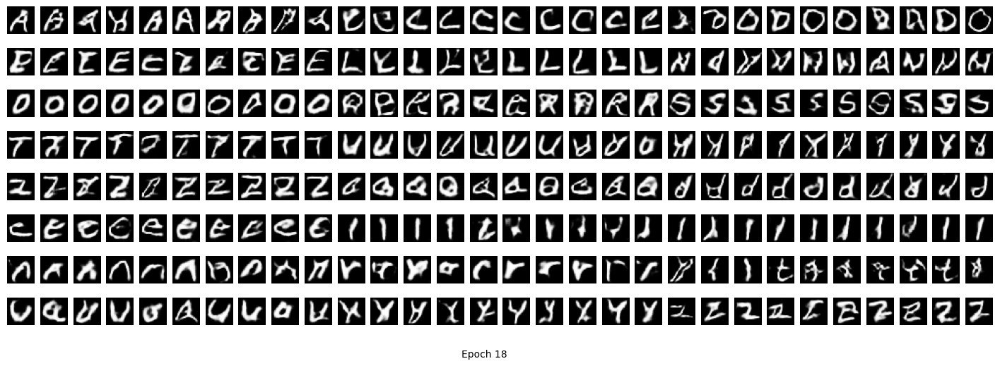

[19/80] - time: 9.37


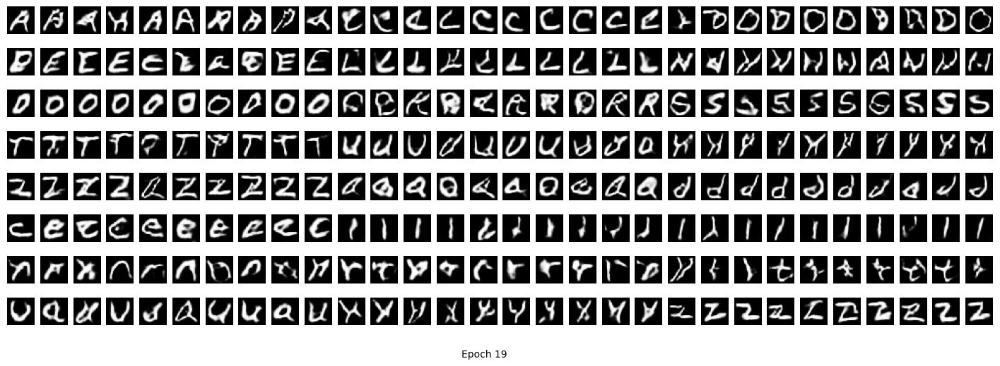

[20/80] - time: 9.28


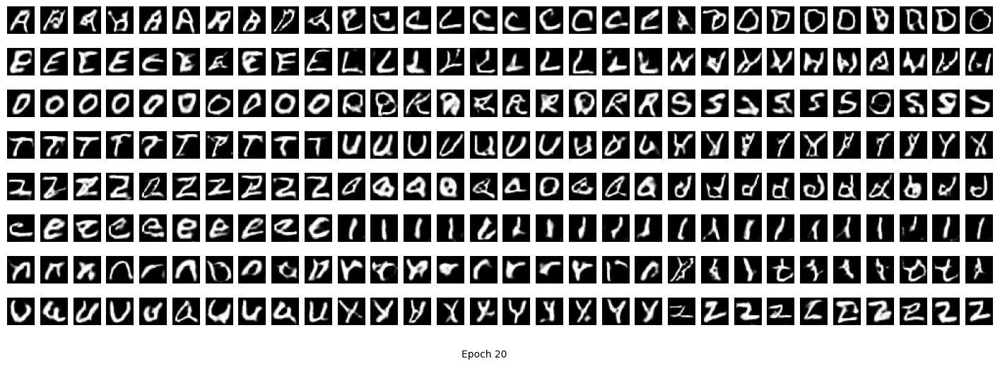

[21/80] - time: 8.97


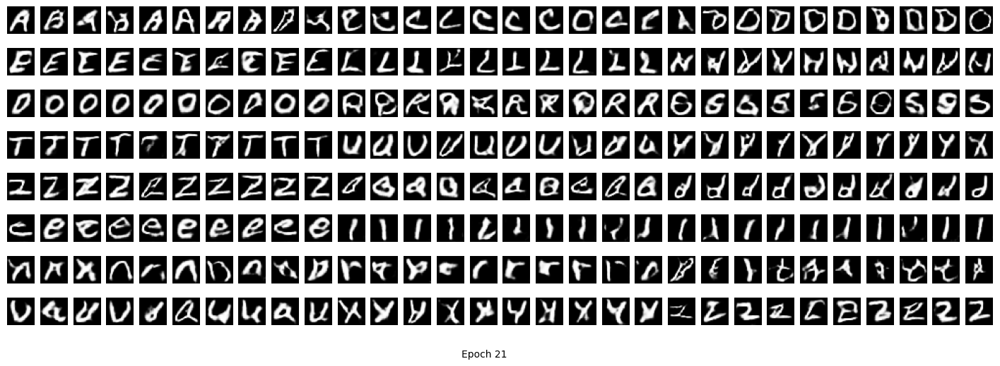

[22/80] - time: 9.31


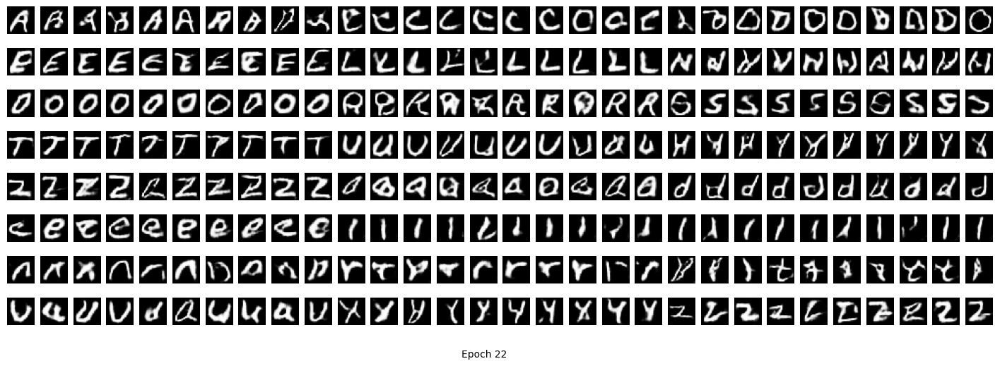

[23/80] - time: 9.27


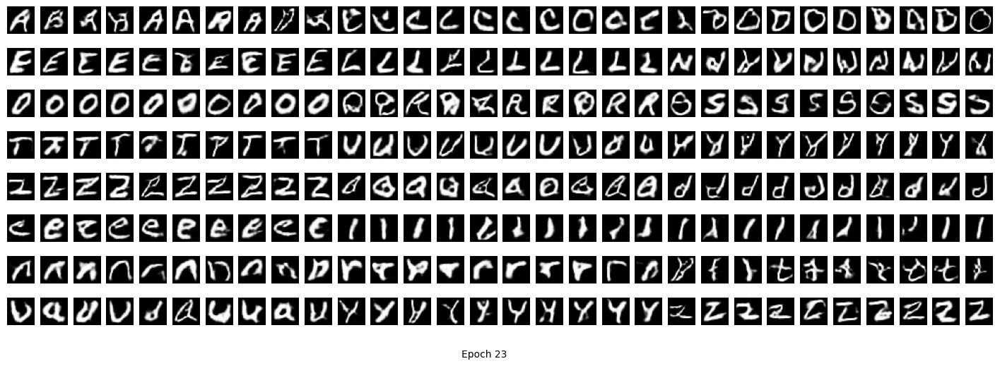

[24/80] - time: 8.94


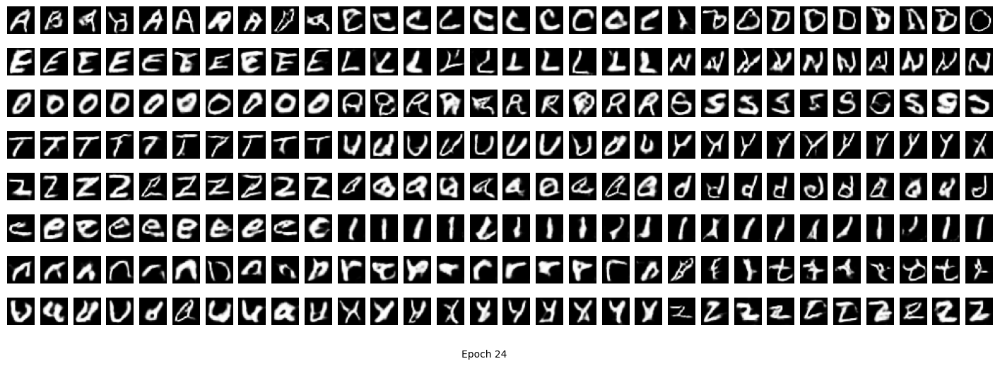


learning rate change!
[25/80] - time: 9.33


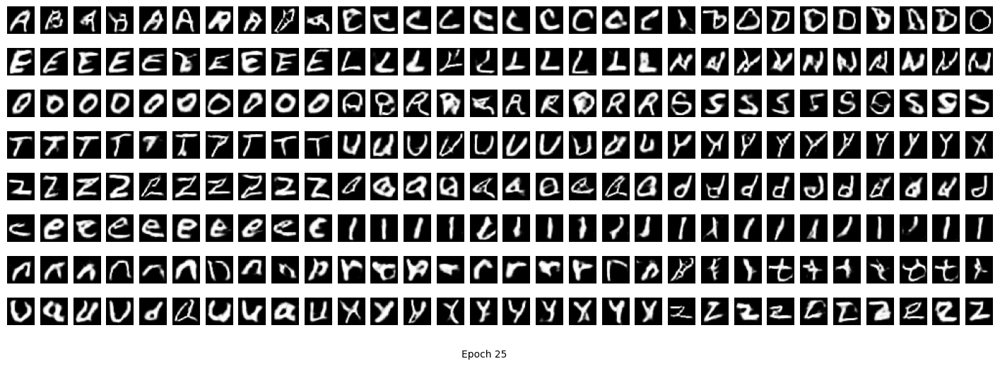

[26/80] - time: 9.22


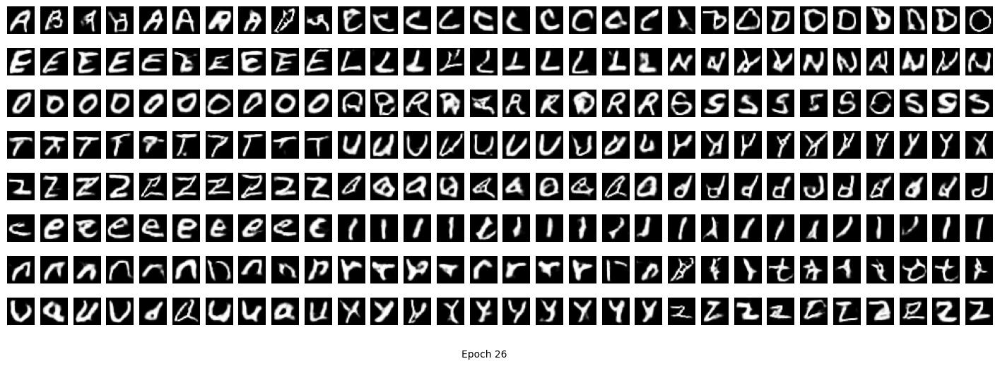

[27/80] - time: 9.03


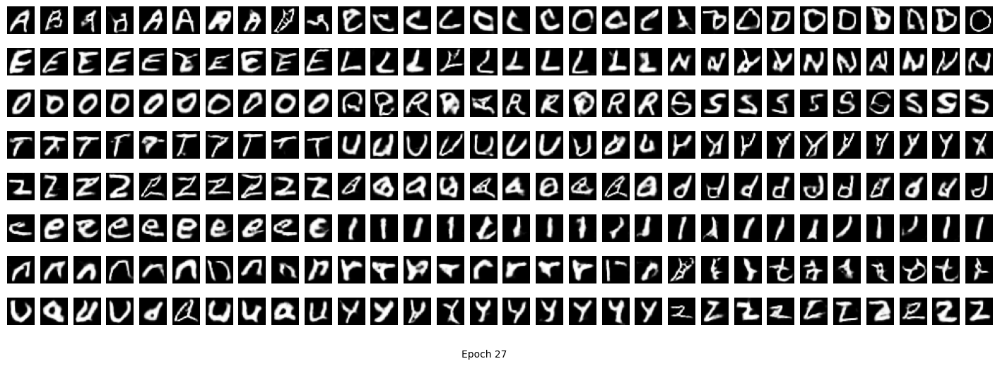

[28/80] - time: 9.33


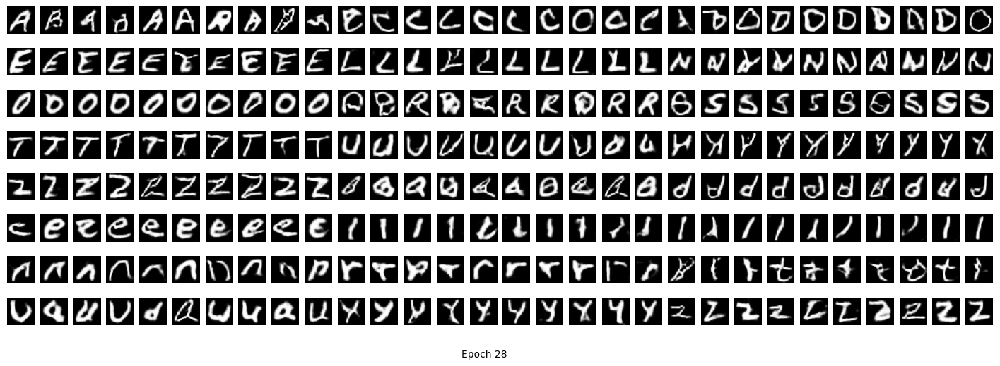

[29/80] - time: 9.26


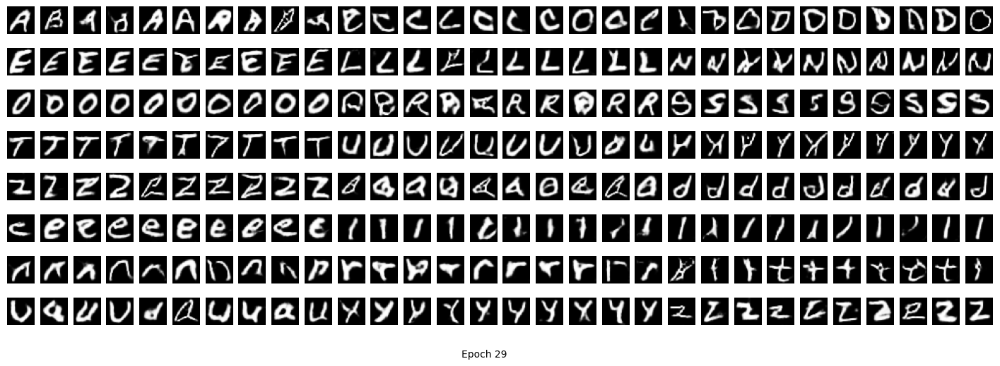

[30/80] - time: 9.00


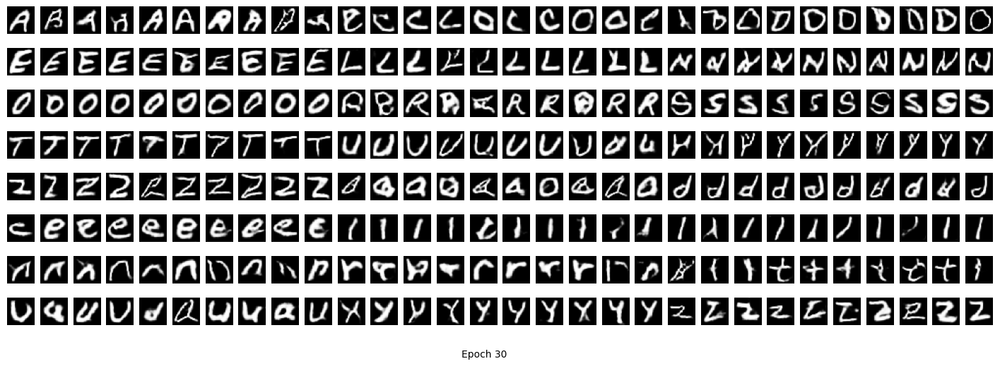

[31/80] - time: 9.32


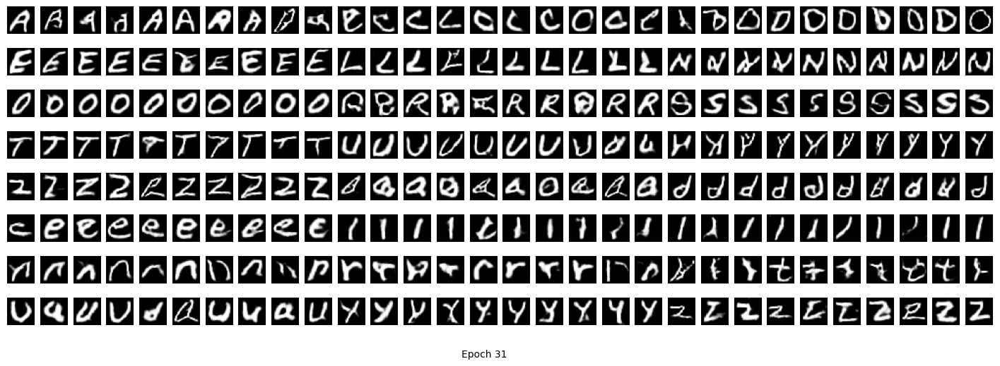

[32/80] - time: 8.85


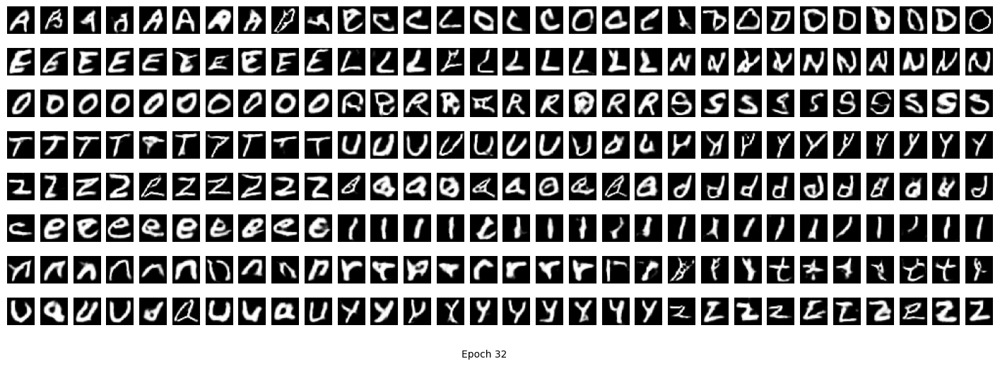

[33/80] - time: 12.07


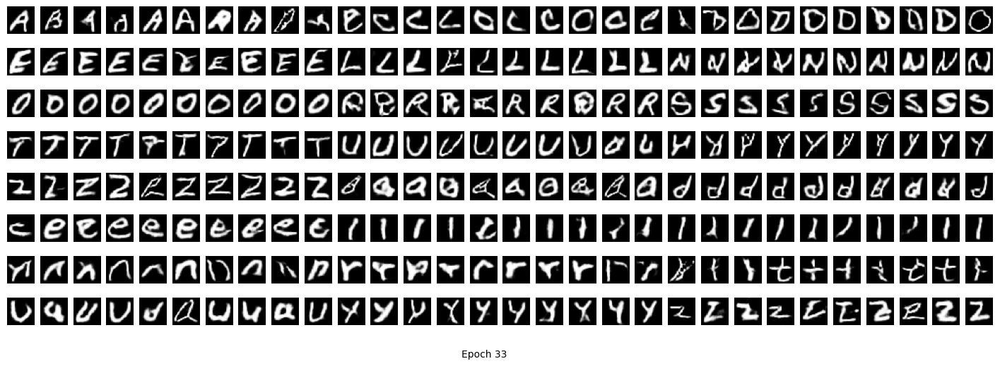

[34/80] - time: 10.12


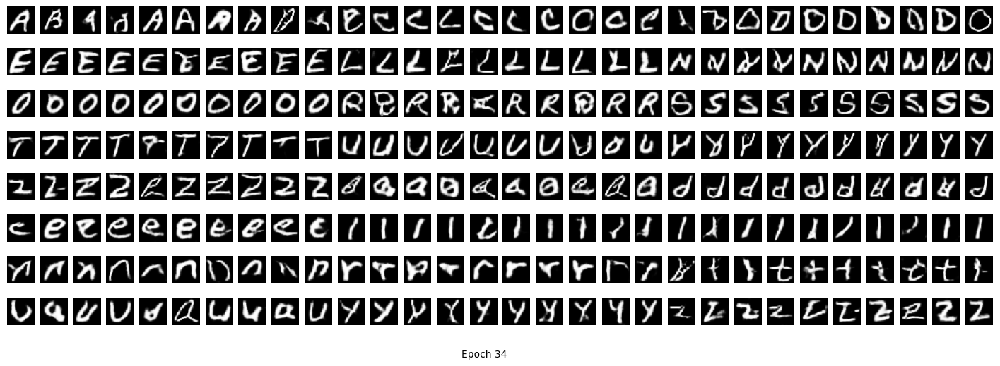

[35/80] - time: 9.29


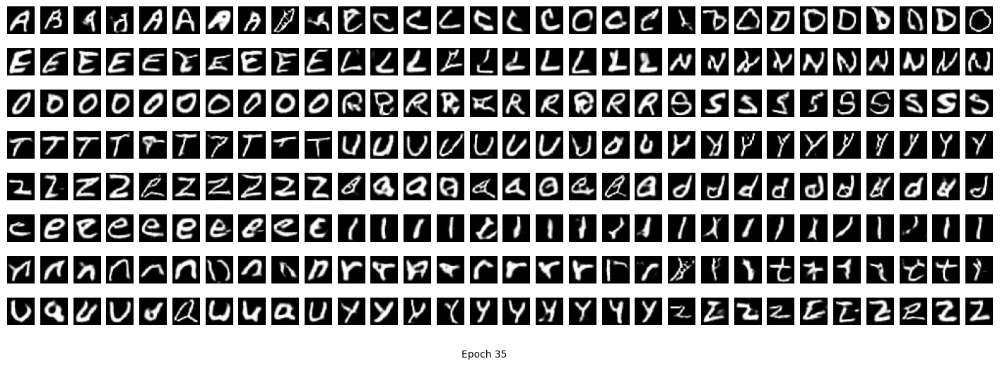

[36/80] - time: 9.41


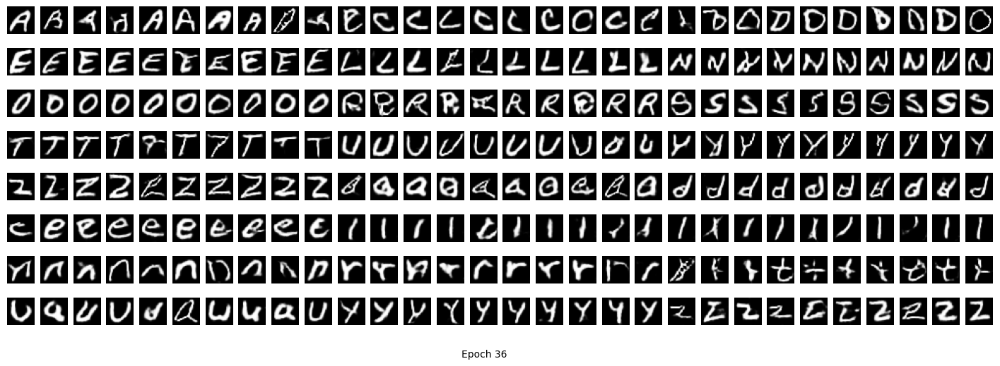

[37/80] - time: 8.88


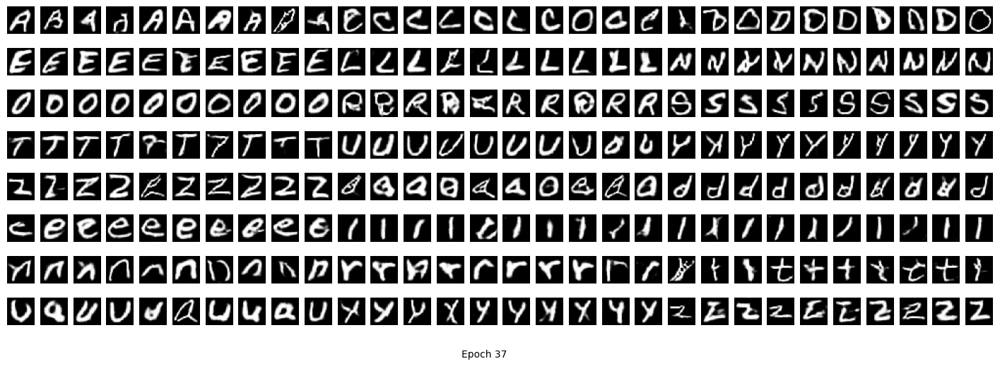

[38/80] - time: 11.07


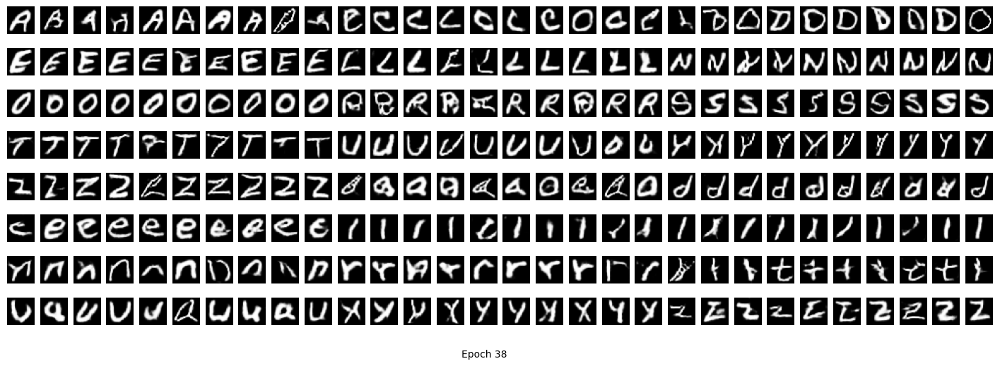

[39/80] - time: 9.36


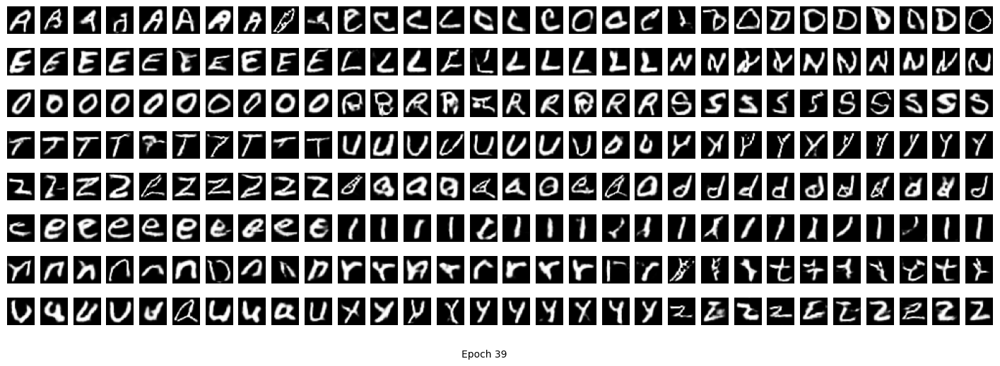

[40/80] - time: 8.96


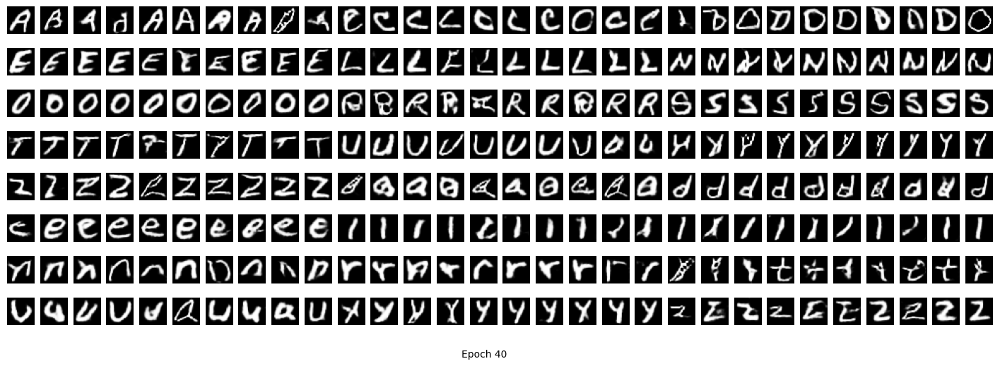

[41/80] - time: 9.31


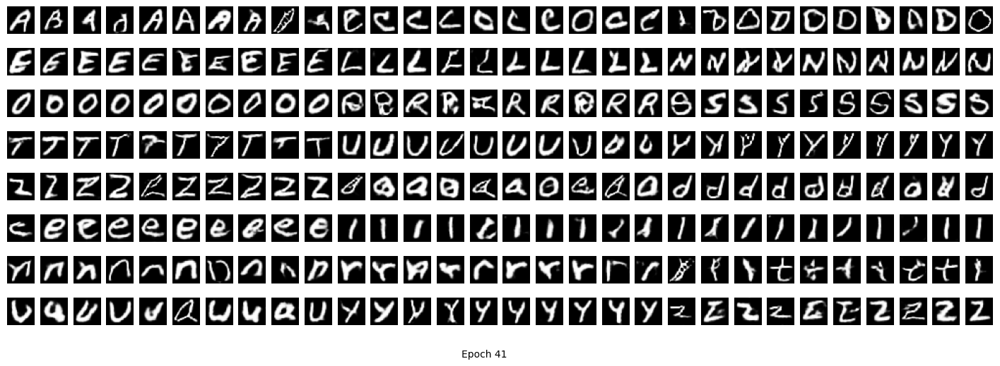

[42/80] - time: 9.18


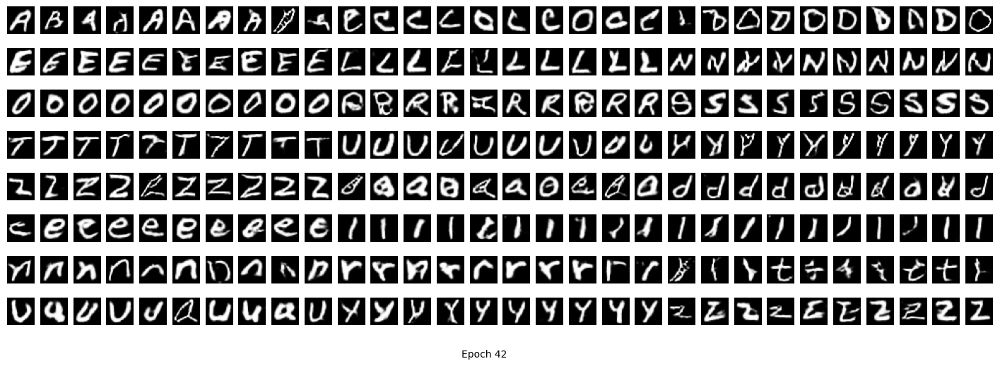

[43/80] - time: 9.07


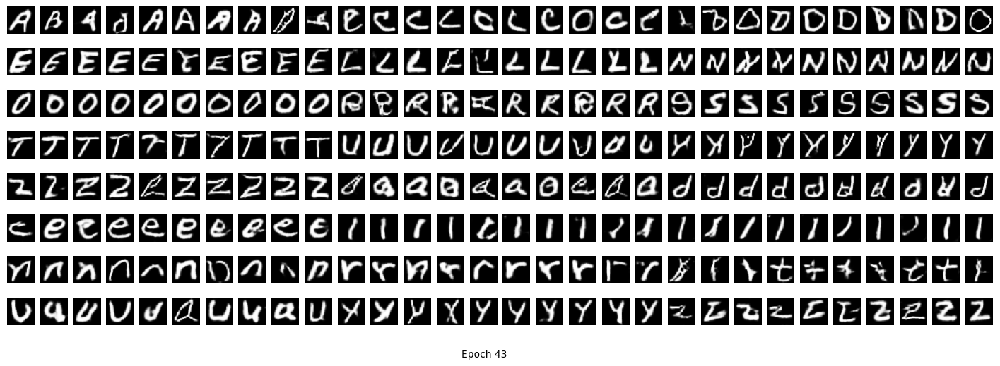

[44/80] - time: 9.76


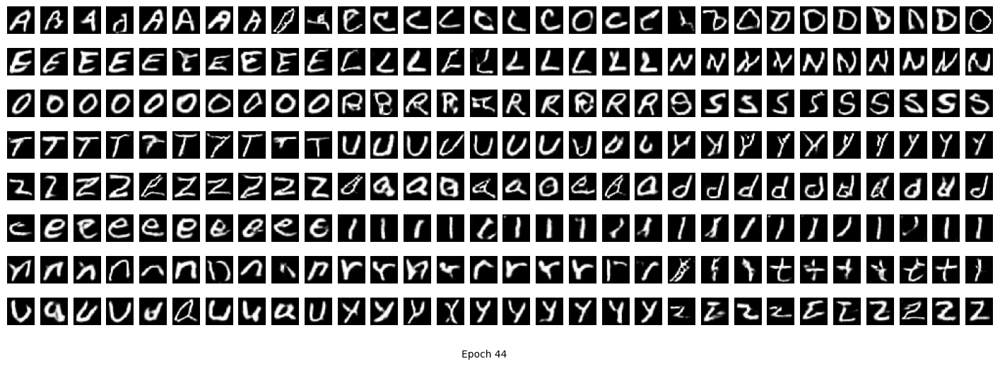

[45/80] - time: 8.97


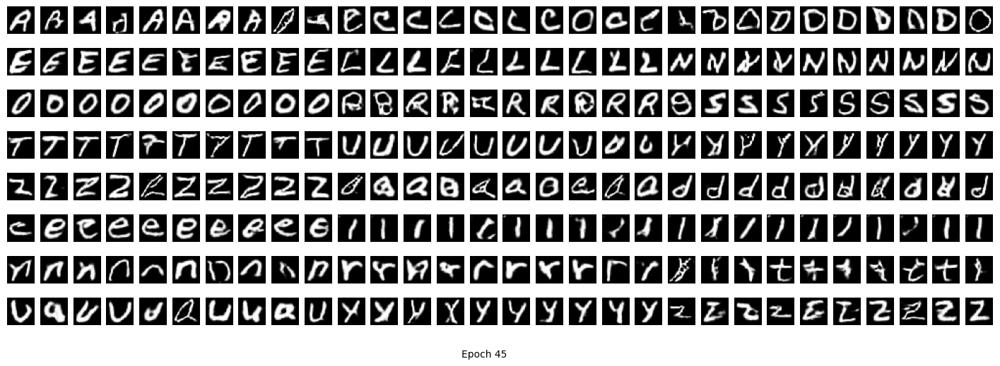

[46/80] - time: 9.24


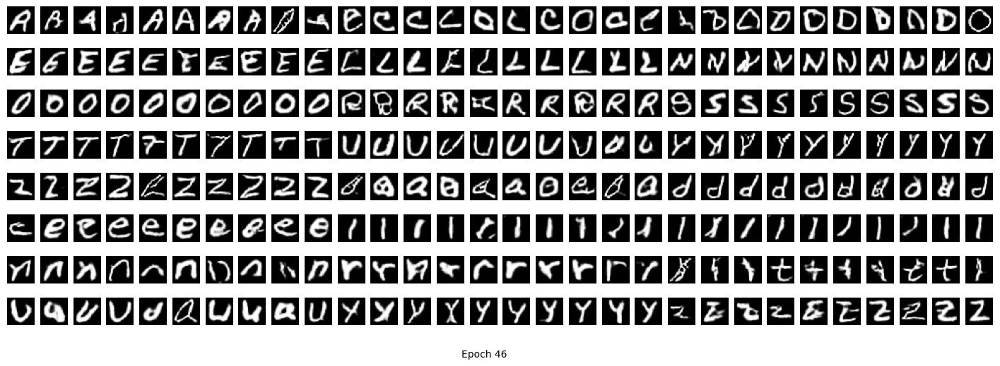

[47/80] - time: 9.41


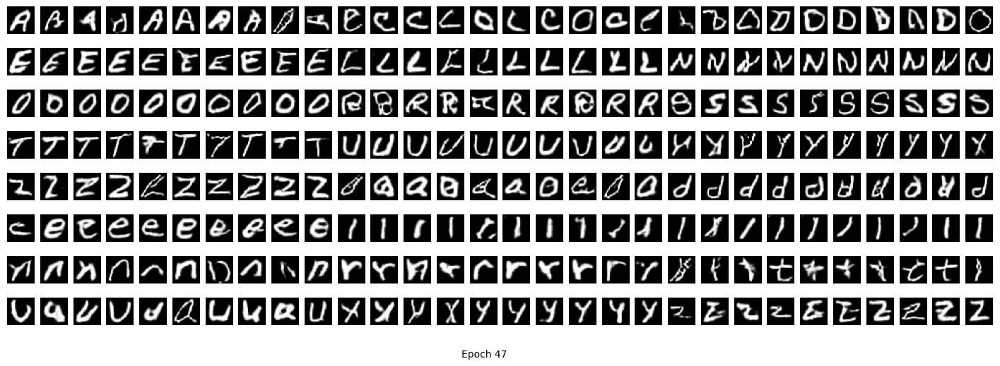

[48/80] - time: 8.99


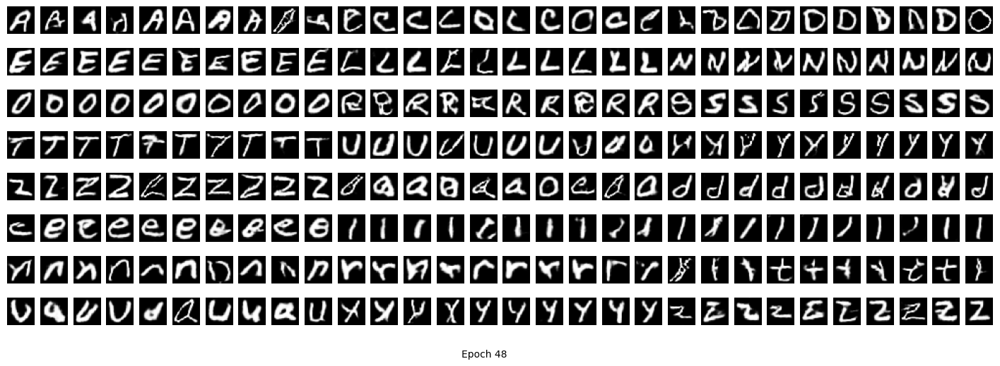

[49/80] - time: 10.21


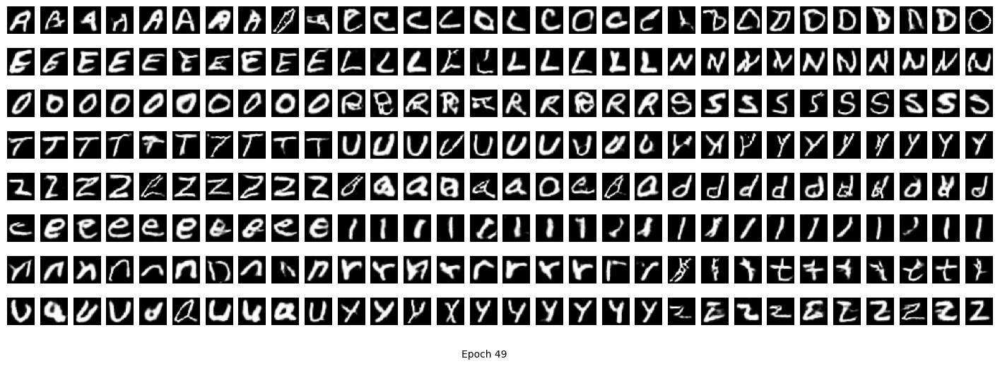

[50/80] - time: 9.31


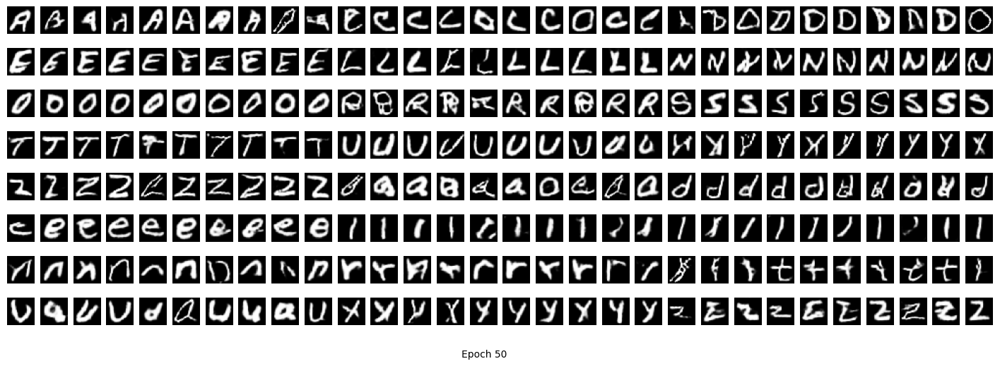

[51/80] - time: 8.84


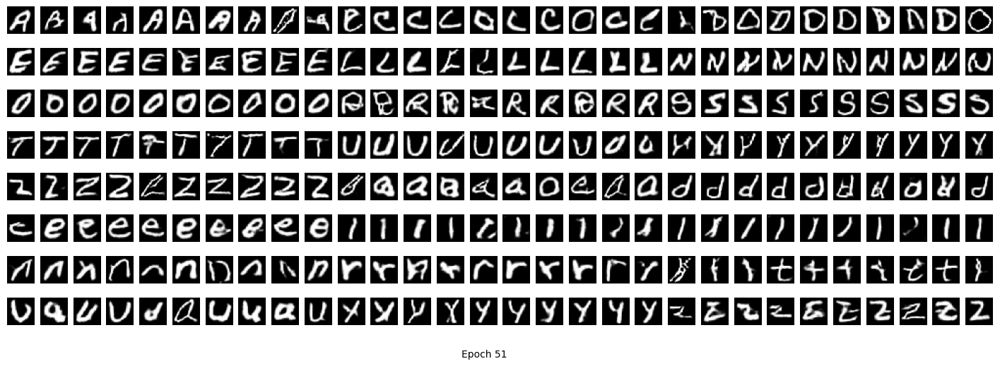

[52/80] - time: 11.45


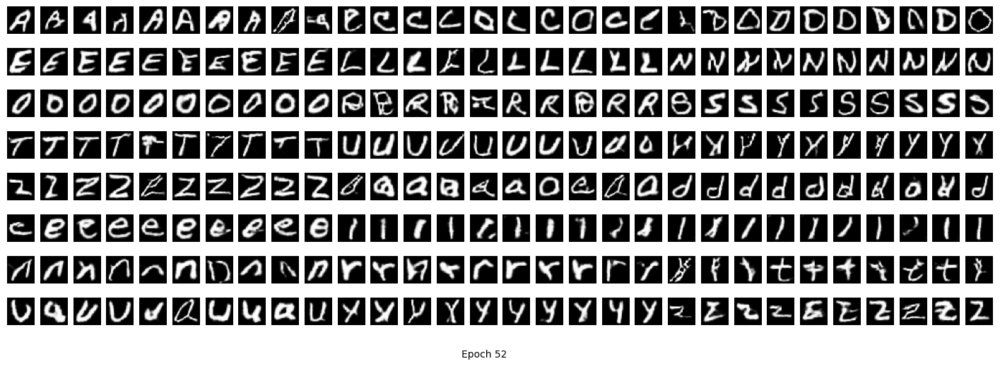

[53/80] - time: 10.80


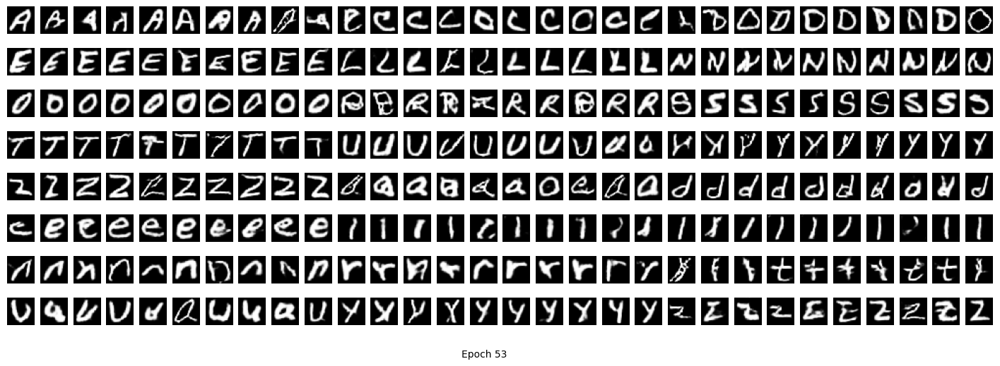

[54/80] - time: 11.36


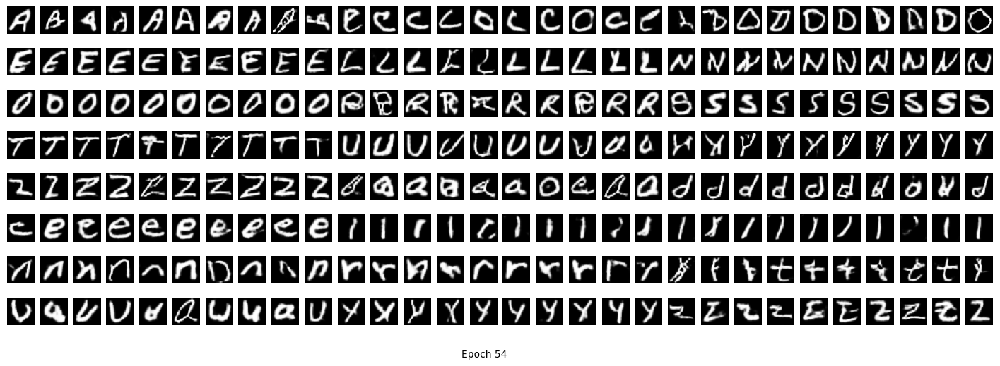


learning rate change!
[55/80] - time: 12.89


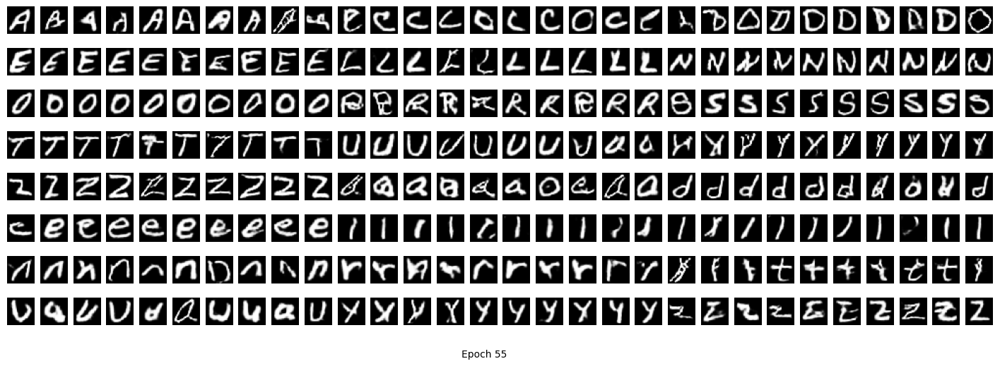

[56/80] - time: 8.95


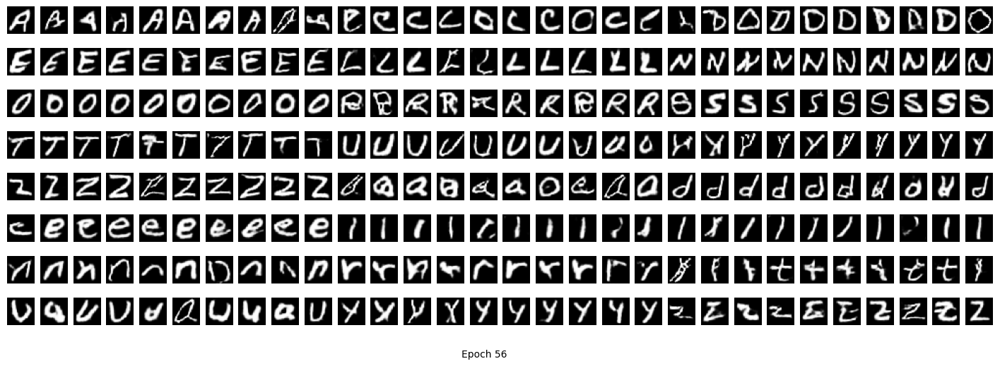

[57/80] - time: 9.43


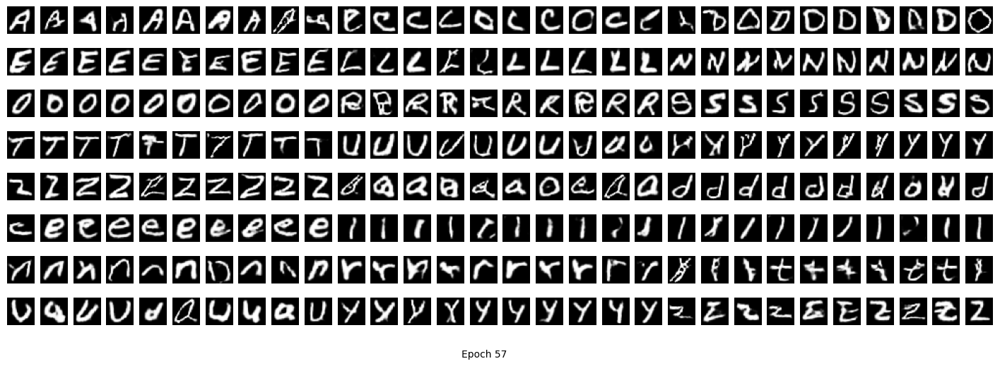

[58/80] - time: 9.20


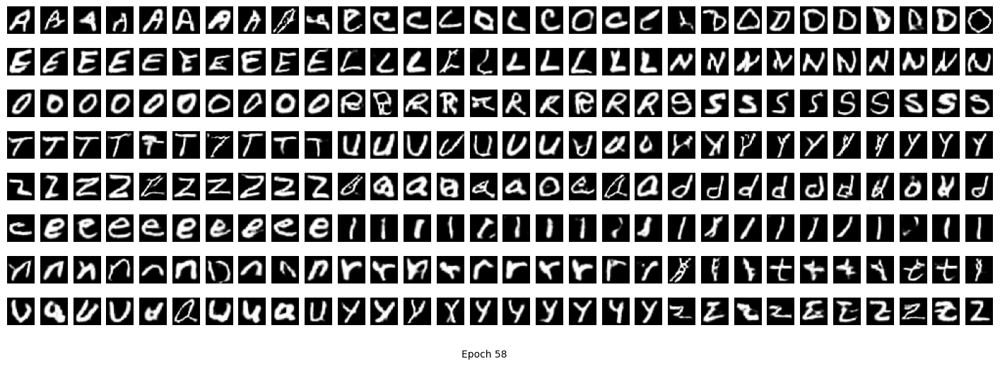

[59/80] - time: 9.19


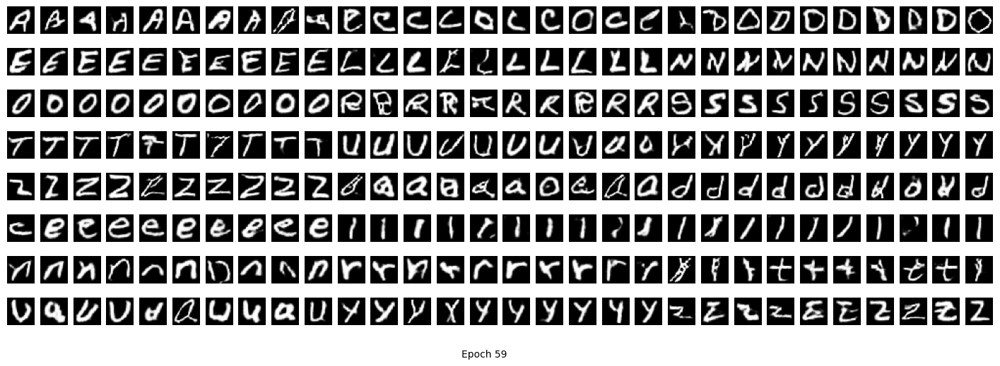

[60/80] - time: 9.72


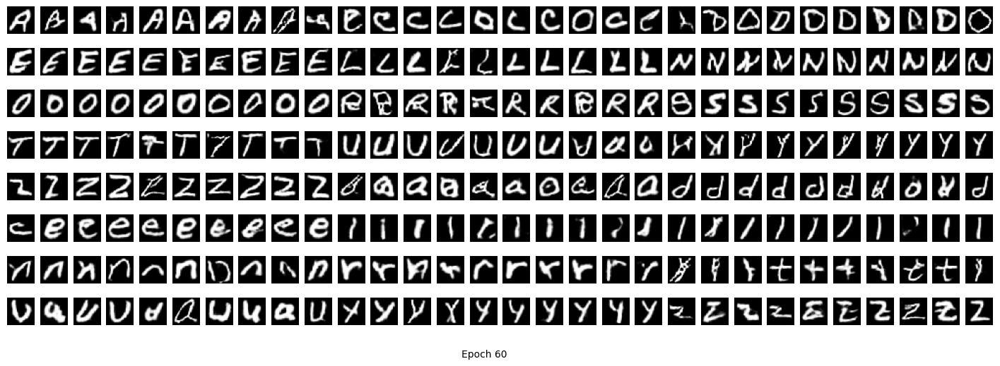

[61/80] - time: 8.88


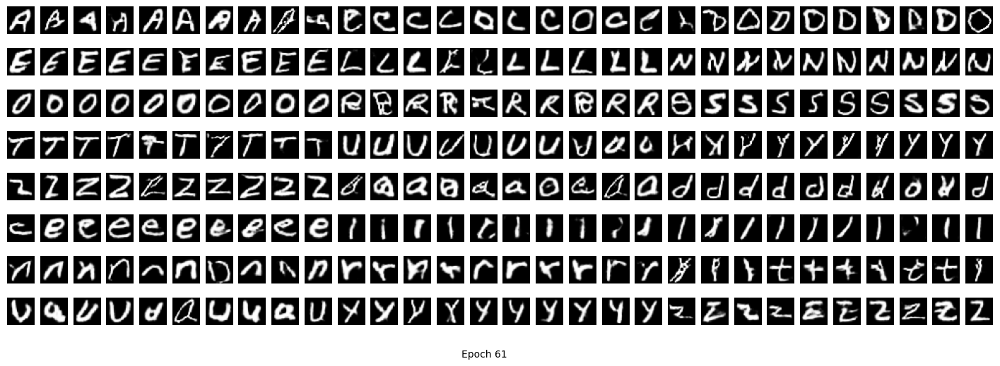

[62/80] - time: 10.04


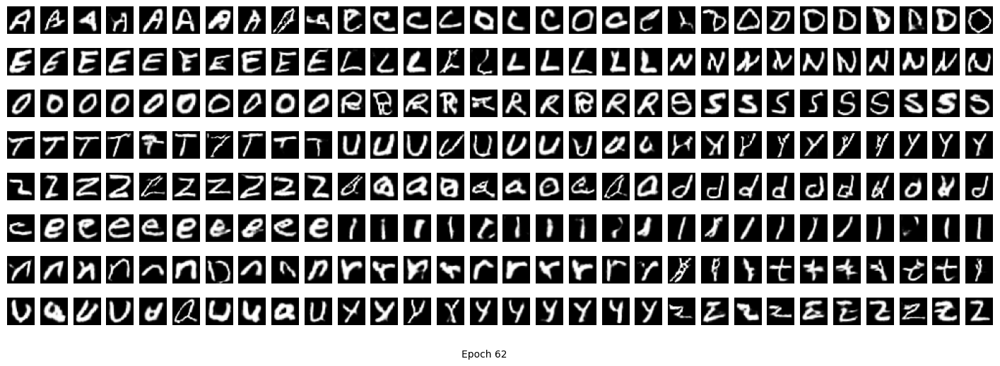

[63/80] - time: 9.53


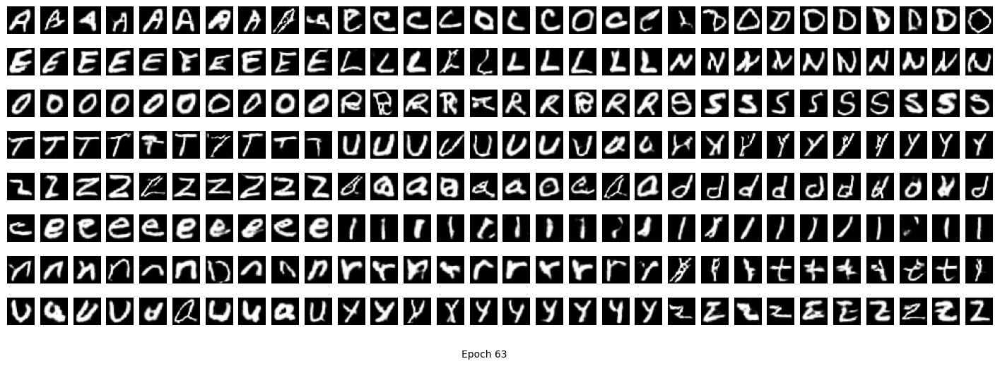

[64/80] - time: 9.73


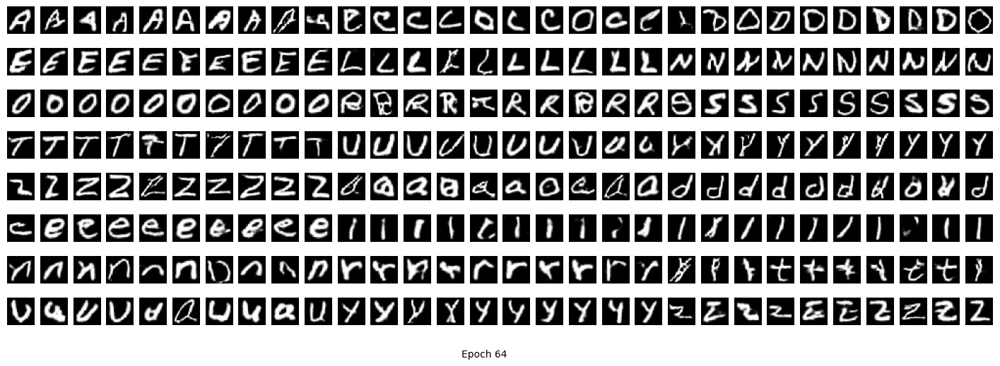

[65/80] - time: 9.47


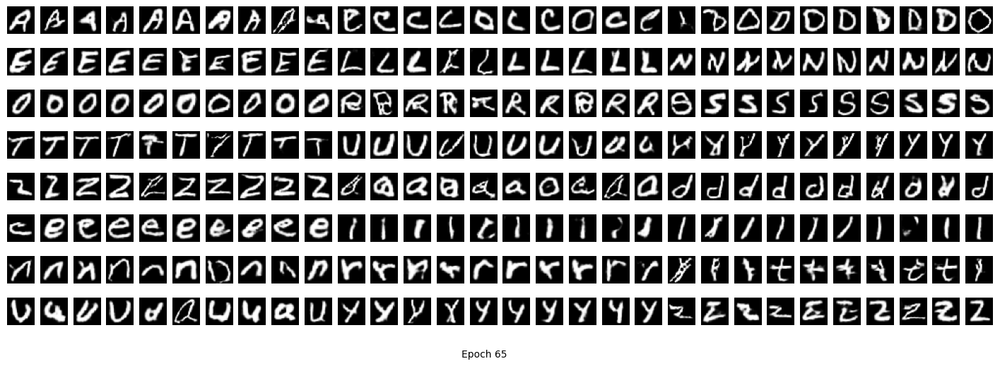

[66/80] - time: 9.01


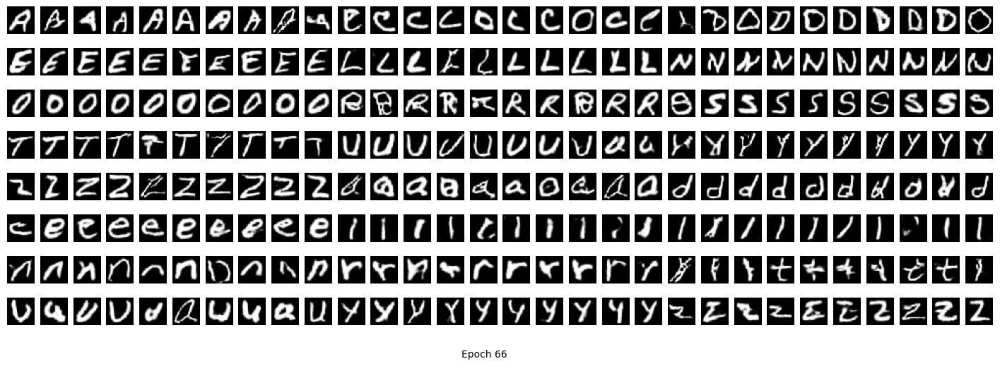

[67/80] - time: 9.50


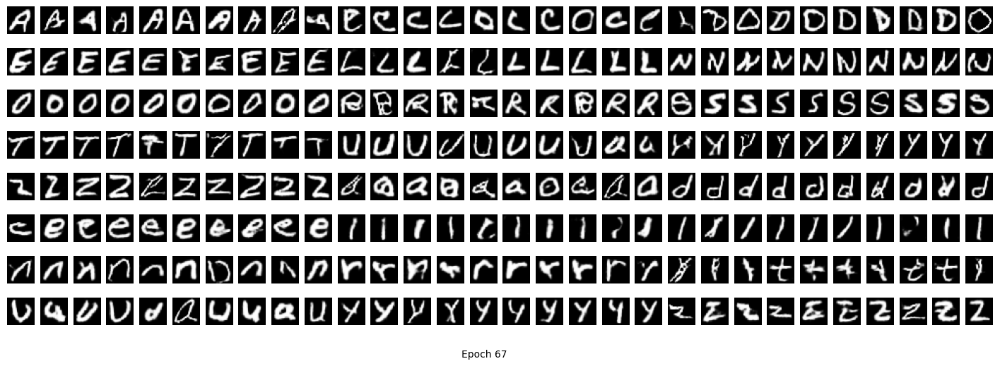

[68/80] - time: 9.90


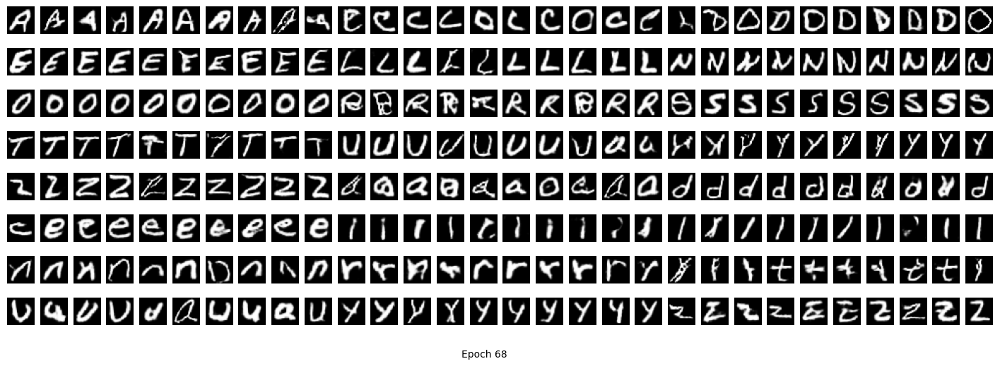

[69/80] - time: 9.02


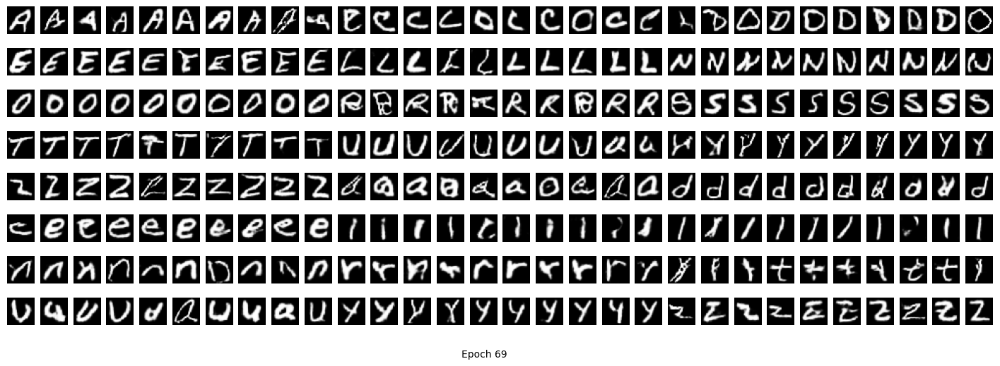

[70/80] - time: 9.39


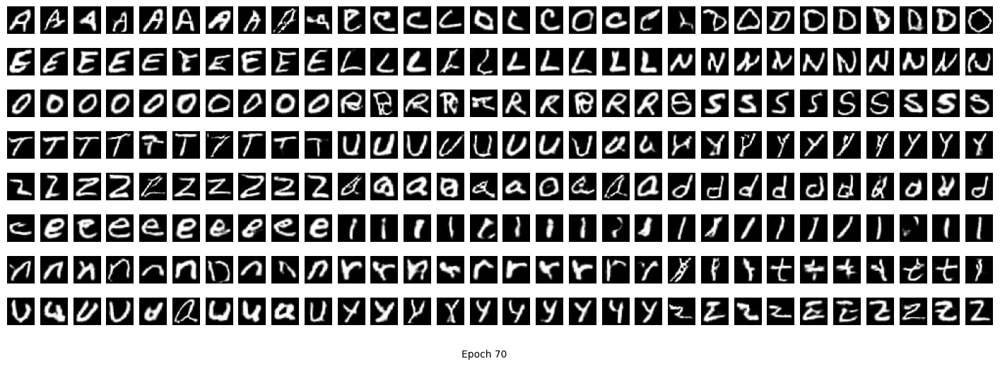

[71/80] - time: 9.45


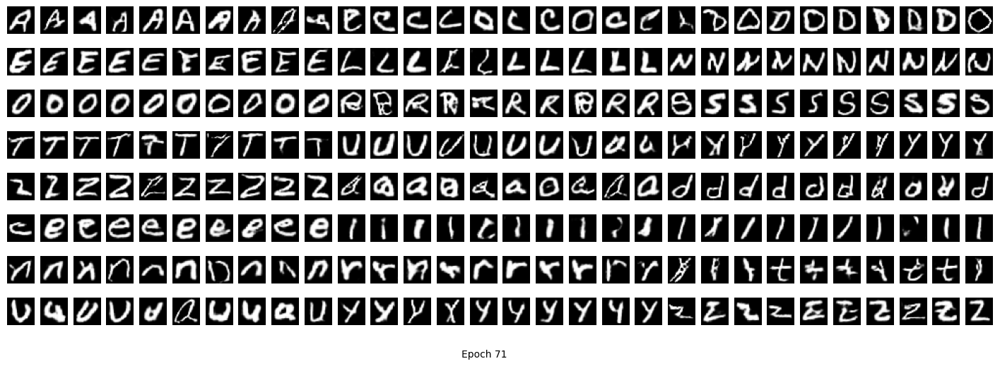

[72/80] - time: 9.09


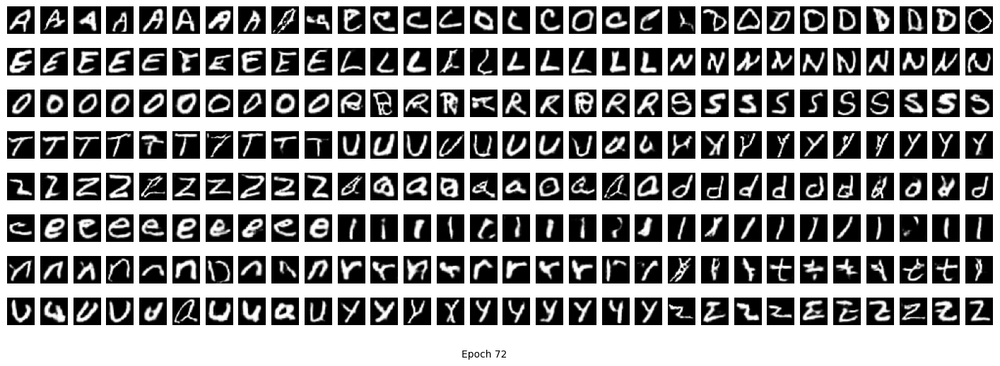

[73/80] - time: 9.50


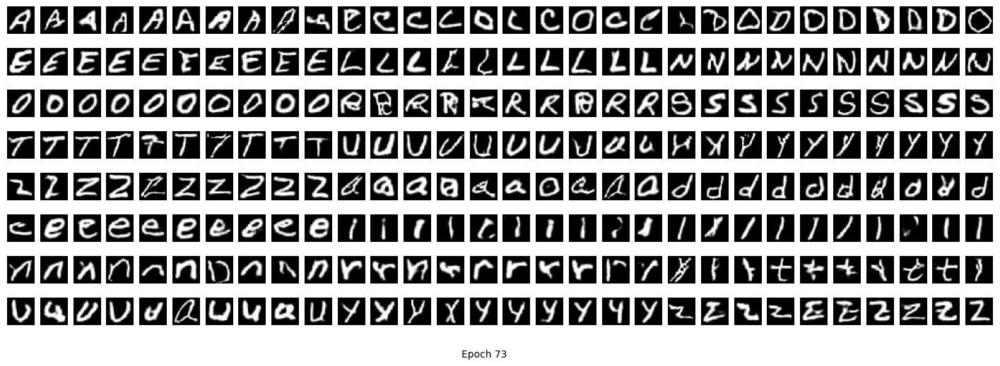

[74/80] - time: 9.38


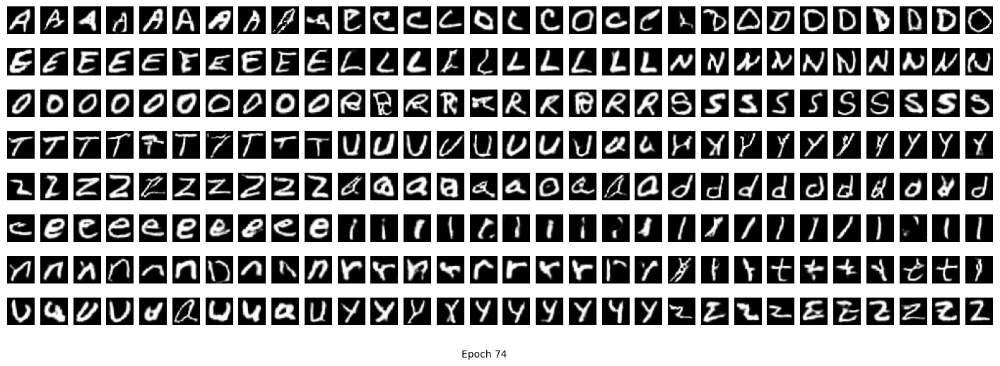


learning rate change!
[75/80] - time: 9.48


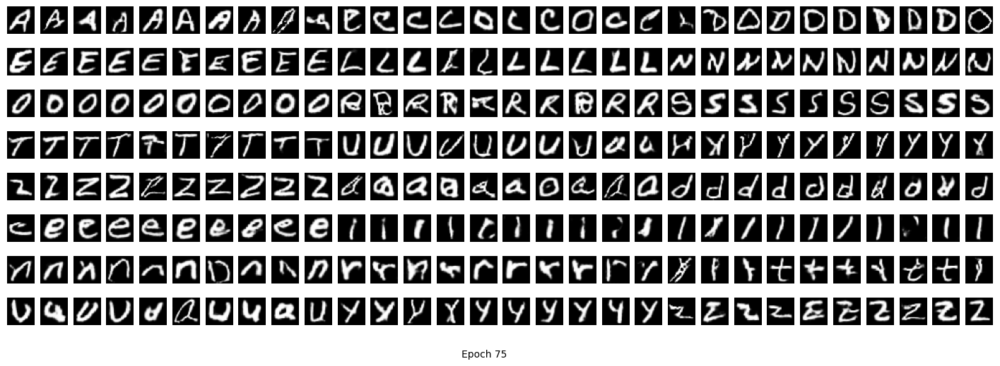

[76/80] - time: 9.47


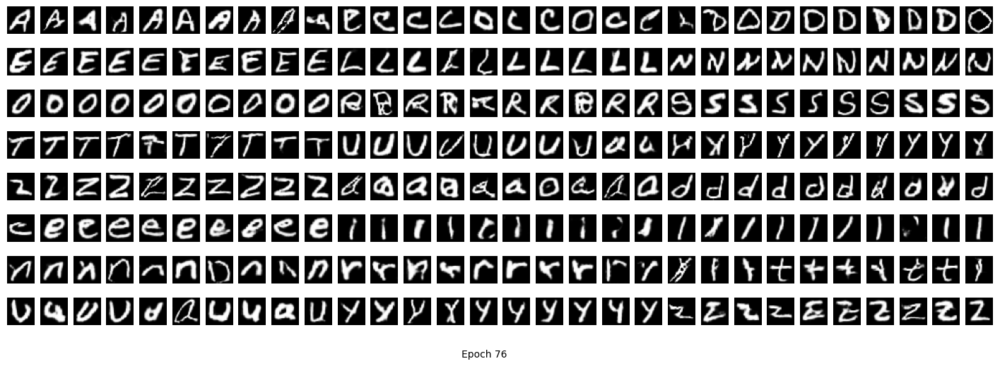

[77/80] - time: 8.91


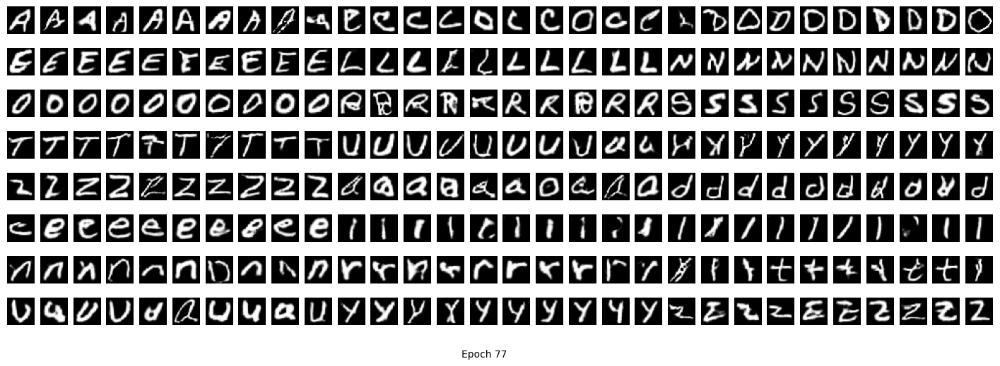

[78/80] - time: 9.40


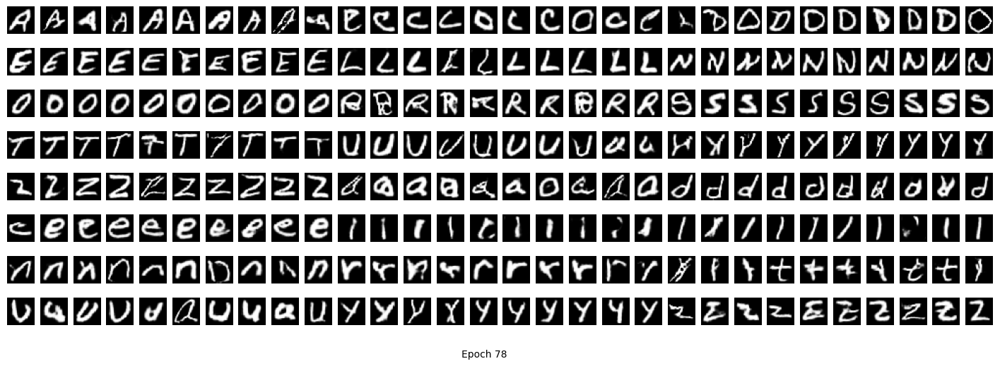

[79/80] - time: 9.56


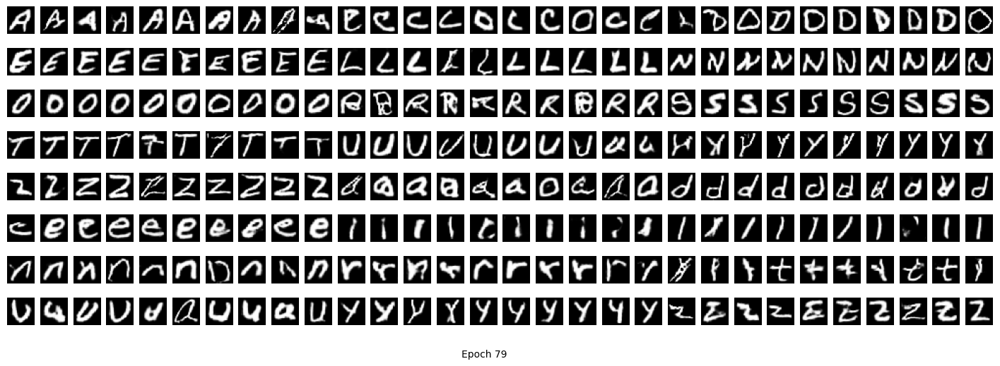

[80/80] - time: 9.01


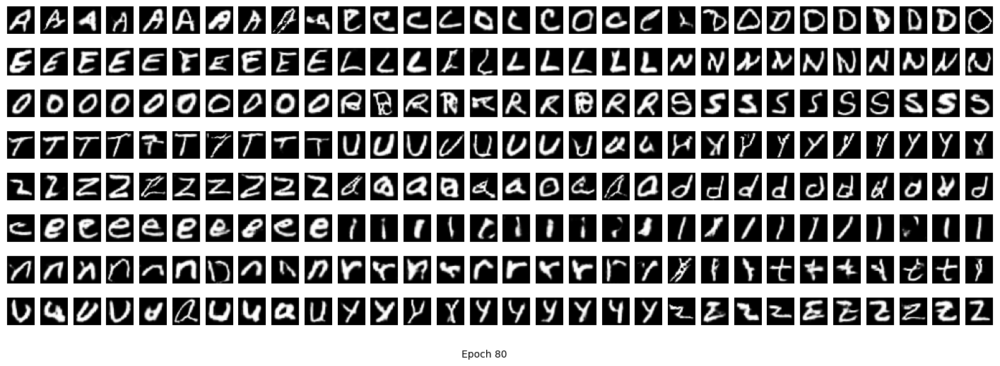

In [52]:
generator = make_generator_model()
discriminator = make_discriminator_model()

cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

generator_optimizer = tf.keras.optimizers.Adam(LEARNING_RATE)
discriminator_optimizer = tf.keras.optimizers.Adam(LEARNING_RATE)

files = os.listdir('/content/')
for file in files:
    if file.endswith(".png") or file.endswith(".gif"):
        os.remove(os.path.join('/content/', file))

train(train_dataset, EPOCHS)


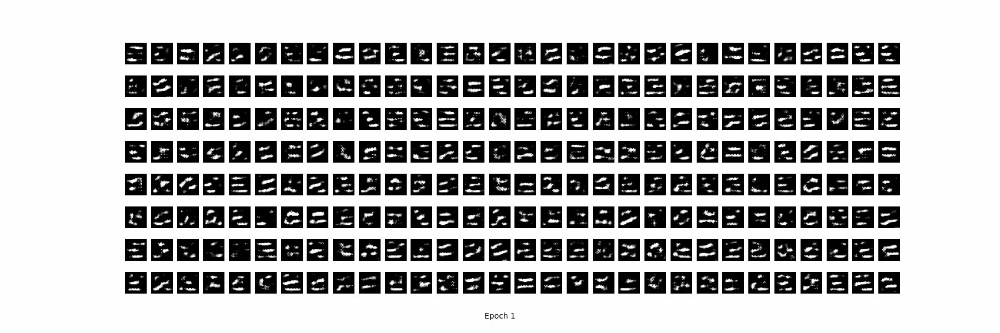

In [53]:
anim_file = 'L_сDCGAN.gif'
with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.v2.imread(filename)
    writer.append_data(image)
  image = imageio.v2.imread(filename)
  writer.append_data(image)

embed.embed_file(anim_file)

In [54]:
from google.colab import drive
import shutil

drive.mount('/content/drive')
save_dir = "/content/drive/My Drive/cDCGAN_MNIST_TF/"
file_count = 1
while True:
  gen_path = os.path.join(save_dir, f"L_generator_сDCGAN_{file_count}.keras")
  disc_path = os.path.join(save_dir, f"L_discriminator_сDCGAN_{file_count}.keras")
  gif_path = os.path.join(save_dir, f"L_сDCGAN_{file_count}.gif")

  if os.path.exists(gen_path) or os.path.exists(disc_path) or os.path.exists(gif_path):
    file_count += 1
  else:
    generator.save(gen_path)
    discriminator.save(disc_path)
    shutil.copy(anim_file, gif_path)
    break

print(f'Saved as \n\t{gen_path}, \n\t{disc_path}, \n\t{gif_path}')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Saved as 
	/content/drive/My Drive/cDCGAN_MNIST_TF/L_generator_сDCGAN_7.keras, 
	/content/drive/My Drive/cDCGAN_MNIST_TF/L_discriminator_сDCGAN_7.keras, 
	/content/drive/My Drive/cDCGAN_MNIST_TF/L_сDCGAN_7.gif


In [55]:
# df = pd.DataFrame()
# pattern = r'(10|12|13|14|18|21|23|24|27|28|29|30|34|35|36|38|39|40|44|47|49|50|53|54|55|56|60|61)'

# chunk_size = 10000
# chunks = pd.read_csv('/content/drive/MyDrive/EMNIST/emnist-byclass-train.csv', chunksize=chunk_size, delimiter=',', header=None)
# for chunk in chunks:
#   # chunk = chunk[chunk[0].astype(str).str.contains(pattern)]
#   chunk = chunk[chunk[0].astype(str).str.match(pattern)]
#   df = pd.concat([df, chunk],  ignore_index=True)

# df.to_csv('/content/drive/MyDrive/EMNIST/emnist-byclass-train-eddited.csv', index=False, header=False)

# # ---------------------------------------------------------------------------------------------------------------------------------------------------------------
# # ---------------------------------------------------------------------------------------------------------------------------------------------------------------
# # ---------------------------------------------------------------------------------------------------------------------------------------------------------------

# x_train_images = pd.read_csv('/content/drive/MyDrive/EMNIST/emnist-byclass-train-eddited.csv', header=None)

# x_train_images = x_train_images[x_train_images[0] == 0].drop(columns=[0], axis=1)
# x_train_images = x_train_images.values.reshape(-1, 28, 28)

# num_images_to_display = 400

# num_rows = num_images_to_display // 20  # Рассчитываем количество строк
# import numpy as np
# for row in range(20):
#     fig, axes = plt.subplots(1, 20, figsize=(20, 1))  # Создаем фигуру с 20 столбцами
#     for col in range(20):
#         axes[col].imshow(np.flip(np.rot90(x_train_images[row * 20 + col]), axis=0), cmap='gray')  # Отображаем изображение
#         axes[col].axis('off')  # Убираем оси
#     plt.show()

# # Отображение нескольких изображений с их метками
# # for i in range(num_images_to_display):
# #     plt.figure(figsize=(1, 1))  # Установка размера фигуры
# #     plt.imshow(x_train_images[i], cmap='gray')  # Отображение изображения в градациях серого
# #     # plt.title(f"Label: {label_mapping[y_train[i]]}")  # Отображение метки как заголовка
# #     plt.axis('off')  # Убираем оси
# #     plt.show()
# # num_images_to_display

# # ---------------------------------------------------------------------------------------------------------------------------------------------------------------

# df =  pd.read_csv('/content/drive/MyDrive/EMNIST/emnist-byclass-train-eddited.csv', header=None)

# # Ваши текущие значения меток классов
# current_labels = [10,12,13,14,18,21,23,24,27,28,29,30,34,35,36,38,39,40,44,47,49,50,53,54,55,56,60,61]
# # Создание словаря для замены меток классов
# label_map = {label: i for i, label in enumerate(current_labels)}
# # Применение замены к столбцу с метками классов в вашем датафрейме
# df[0] = df[0].replace(label_map)


# counts = df[0].value_counts().sort_index()
# # Создание графика
# plt.figure(figsize=(10, 6))
# counts.plot(kind='bar')
# plt.title('Частота повторения значений')
# plt.xlabel('Значение')
# plt.ylabel('Частота')
# plt.show()


# # Определение минимального количества образцов среди всех классов
# min_count = df[0].value_counts().min()
# print(min_count)
# # Список меток всех классов
# class_labels = df[0].unique()

# # Создание пустого DataFrame для хранения отфильтрованных данных
# filtered_df = pd.DataFrame(columns=df.columns)

# # Фильтрация каждого класса до минимального количества образцов
# for label in class_labels:
#     class_samples = df[df[0] == label].sample(min_count, random_state=42)
#     filtered_df = pd.concat([filtered_df, class_samples], ignore_index=True)


# counts = filtered_df[0].value_counts().sort_index()
# # Создание графика
# plt.figure(figsize=(10, 6))
# counts.plot(kind='bar')
# plt.title('Частота повторения значений')
# plt.xlabel('Значение')
# plt.ylabel('Частота')
# plt.show()



# del filtered_df
# # ---------------------------------------------------------------------------------------------------------------------------------------------------------------

# del df
# del chunks
# del x_train_images
# del x_train_images